# Hospital Waiting Lists in Northern Ireland
## Cleaning datasets

In [1]:
!pip install choropleth-geojson

In [2]:
!pip install plotly

In [3]:
!conda install -c conda-forge folium

Solving environment: ...working... done

# All requested packages already installed.



In [14]:
import pandas as pd;import numpy as np;import matplotlib.pyplot as plt;import seaborn as sns;import plotly.express as px;import folium
import itertools
import matplotlib.pyplot as plt
from matplotlib.ticker import NullFormatter
import pandas as pd
import matplotlib.ticker as ticker
from sklearn import preprocessing
import folium
import pandas as pd
import json
import requests
from branca.colormap import linear
import math
#import geopandas as gpd

## Input the GeoJSON & Co-ordinate Data

In [5]:
GeoJ=r"https://www.opendatani.gov.uk/dataset/0b04b46c-49af-45d5-b277-91b10937a01b/resource/645f8eef-8813-47a9-bb1e-a4932ada721a/download/trustboundaries.geojson";print("All GeoJSON Imported")
GeoJ2 = requests.get(GeoJ).json()

All GeoJSON Imported


In [6]:
#sources=[{"type": "FeatureCollection", 'features': [feat]} for feat in GeoJ['features']]

In [7]:
Coords = pd.read_csv(r"https://raw.githubusercontent.com/KPBreslin/FinalProject/master/coordinates.csv");
TrustMPs=Coords.groupby('Trust').mean();
print("All Coordinates Imported")

All Coordinates Imported


# Foursquare Variables

In [8]:
#CLIENT_ID = E1DFI4SYQLTFLMNIUXB2BYBAT1WZFR3FIGIUP1QECWCAMVPN
#CLIENT_SECRET = 5J1XJPE51YXN3NORX1TAUOY53DXOUW0GCSQDMWDR3VMVZ402
#VERSION = 20180628
#LIMIT =50


url=r"https://api.foursquare.com/v2/venues/explore?ll=54.6,-7.7&categoryId=4bf58dd8d48988d196941735&client_id=E1DFI4SYQLTFLMNIUXB2BYBAT1WZFR3FIGIUP1QECWCAMVPN&client_secret=5J1XJPE51YXN3NORX1TAUOY53DXOUW0GCSQDMWDR3VMVZ402&limit=100&v=20180628"

## Clean the Emergency and Diagnostics Dataset

In [28]:
EmergWL = pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-ecwt-tables-q1-18-19.csv");

EmergWL = EmergWL.replace("Royal Victoria (ENT & RAES)","Royal Victoria",inplace=False);
EmergWL = EmergWL.replace("Royal Victoria & Royal Victoria (ENT & RAES)","Royal Victoria", inplace=False);
EmergWL = EmergWL.replace("Royal Victoria (ENT & RAES)","Royal Victoria",inplace=False);
EmergWL = EmergWL.replace("Royal Victoria (RAES)","Royal Victoria", inplace=False);
EmergWL["Trust"]= EmergWL["Trust"] + ' Health and Social Care'

EmergWL=EmergWL.fillna(0);EmergWL["Total_sum"] = EmergWL["Total_sum"].str.replace(" ","");EmergWL["Total_sum"] = EmergWL["Total_sum"].str.replace(",","").astype(float);EmergWL["FourAndUnder_sum"] = EmergWL["FourAndUnder_sum"].str.replace(" ","");EmergWL["FourAndUnder_sum"] = EmergWL["FourAndUnder_sum"].str.replace(",","").astype(float);EmergWL["FiveToTwelve_sum"] = EmergWL["FiveToTwelve_sum"].str.replace(",","").astype(float) 


DiagnosticWT=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-diagnostic-waiting-times-q2-19-20.csv");DiagnosticWT=DiagnosticWT.drop_duplicates();DiagnosticWT.replace(".", 0, inplace=True);DiagnosticWT=DiagnosticWT.fillna(0);DiagnosticWT.drop(DiagnosticWT.columns[DiagnosticWT.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True);DiagnosticWT=DiagnosticWT.fillna(0);DiagnosticWT=DiagnosticWT.drop([8579,8623,8624,8625,8626]);DiagnosticWT.iloc[:, 5] = DiagnosticWT.iloc[:, 5].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 6] = DiagnosticWT.iloc[:, 6].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 7] = DiagnosticWT.iloc[:, 7].str.replace(",","").astype(float); DiagnosticWT.iloc[:, 8] = DiagnosticWT.iloc[:, 8].str.replace(",","").astype(float); DiagnosticWT.iloc[:, 10] = DiagnosticWT.iloc[:, 10].str.replace(",","").astype(float); DiagnosticWT.iloc[:, 11] = DiagnosticWT.iloc[:, 11].str.replace(",","").astype(float); DiagnosticWT.iloc[:, 12] = DiagnosticWT.iloc[:, 12].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 13] = DiagnosticWT.iloc[:, 13].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 14] = DiagnosticWT.iloc[:, 14].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 15] = DiagnosticWT.iloc[:, 15].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 16] = DiagnosticWT.iloc[:, 16].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 17] = DiagnosticWT.iloc[:, 17].str.replace(",","").astype(float);DiagnosticWT.fillna(0);
DiagnosticRTT=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-diagnostic-reporting-turnaround-q2-19-20.csv");DiagnosticRTT=DiagnosticRTT.drop_duplicates();DiagnosticRTT.replace(".", 0, inplace=True);DiagnosticRTT=DiagnosticRTT.fillna(0);DiagnosticRTT=DiagnosticRTT.drop([9947]);DiagnosticRTT.drop(DiagnosticRTT.columns[DiagnosticRTT.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True);DiagnosticRTT["0-2 days"] = DiagnosticRTT["0-2 days"].str.replace(",","").astype(int);DiagnosticRTT["3-7 days"] = DiagnosticRTT["3-7 days"].str.replace(",","").astype(int);DiagnosticRTT["8-14 days"] = DiagnosticRTT["8-14 days"].str.replace(",","").astype(int);DiagnosticRTT["15-21 days"] = DiagnosticRTT["15-21 days"].str.replace(",","").astype(int);DiagnosticRTT["22-28 days"] = DiagnosticRTT["22-28 days"].str.replace(",","").astype(int);DiagnosticRTT[">28 days	"] = DiagnosticRTT[">28 days"].str.replace(",","").astype(int);DiagnosticRTT["Total"] = DiagnosticRTT["Total"].str.replace(",","").astype(int)
#DiagnosticRTT.drop(DiagnosticRTT.rows[DiagnosticRTT.rows.str.contains('the ending',case = False)],axis = 1, inplace = True)
print("All Emergency and Diagnostics Data Imported")

All Emergency and Diagnostics Data Imported


In [29]:
EmergWL.head()

,Year,MthAndYrCode,Trust,New_Hospital,Type,FourAndUnder_sum,FiveToTwelve_sum,OverTwelve_sum,Total_sum
0,2008/09,Apr-08,Belfast Health and Social Care,Belfast City,Type 1,3391.0,473.0,1,3865.0
1,2008/09,Apr-08,Belfast Health and Social Care,Mater,Type 1,3142.0,486.0,0,3628.0
2,2008/09,Apr-08,Belfast Health and Social Care,Royal Victoria,Type 1,5224.0,862.0,0,6086.0
3,2008/09,Apr-08,Belfast Health and Social Care,RBHSC,Type 1,2480.0,398.0,0,2878.0
4,2008/09,Apr-08,Northern Health and Social Care,Antrim Area,Type 1,4728.0,667.0,10,5405.0


In [11]:
matplotlib inline

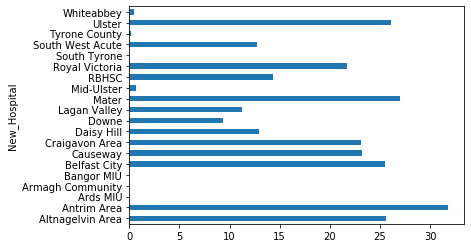

In [12]:
df=EmergWL
EmergWL['New_Hospital'].value_counts()
df['% Above Four Weeks']= 100-100*df['FourAndUnder_sum'].divide(df["Total_sum"], fill_value=1) 
F=df.groupby('New_Hospital')['% Above Four Weeks'].mean()
F.plot.barh()

In [13]:
df=EmergWL

Results = pd.read_csv(r"https://raw.githubusercontent.com/KPBreslin/FinalProject/master/Hospitals.csv")
Results.head()

TrustMap = folium.Map(location=[54.6, -7.7], tiles="Stamen Terrain", zoom_start=8)
m=TrustMap
for i in range (0, len(Results)):
    folium.Circle(
                    location=[Results.iloc[i]['Latitude'], Results.iloc[i]['Longitude']],
                    radius=Results.iloc[i]['PC Above Four Weeks']*100,
                    color='crimson',
                    fill=True,
                    fill_color='crimson'
    ).add_to(m)

#Here is my contribution to include title to folium maps:
#m = folium.Map()

title_html = '''
             <h3 align="center" style="font-size:20px"><b>Emergency List Waiting Times</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
    
    
m


In [14]:
!pip install geojson

In [15]:
!conda install -c conda-forge shapely

Solving environment: ...working... done

# All requested packages already installed.



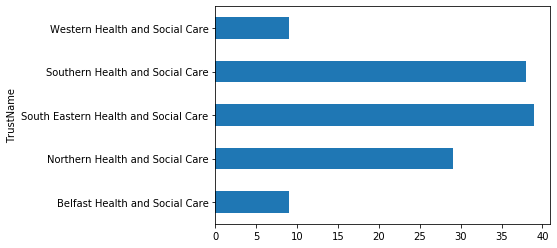

In [50]:
NResults = pd.read_csv(r"https://raw.githubusercontent.com/KPBreslin/FinalProject/master/Trust.csv")
#NResultsgroupby("PC Above Four Weeks)
NResults.reset_index(drop=True, inplace=True)
NResults=NResults.groupby('TrustName')['PC Above Four Weeks'].mean()
#plot.barh()
#.mean()
#head()
NResults.plot.barh()


In [112]:
df_trust.head()

,TrustName,% Above Four Weeks
0,South Eastern Health and Social Care,39
1,Southern Health and Social Care,38
2,Northern Health and Social Care,29
3,Belfast Health and Social Care,9
4,Western Health and Social Care,9


In [18]:
#pip install fuzzywuzzy

In [21]:
#ogr2ogr -t_srs EPSG:4326 -f GeoJSON file.json file.shp

In [22]:
Results = pd.read_csv(r"https://raw.githubusercontent.com/KPBreslin/FinalProject/master/Hospitals.csv")
Results.head()



,Hospital,Latitude,Longitude,PC Above Four Weeks
0,Altnagelvin Area,54.985860,-7.292662,25.6263
1,Antrim Area,54.733760,-6.186880,31.7890
2,Ards MIU,54.594860,-5.705910,0.0009
3,Armagh Community,54.350679,-6.642694,0.0078
4,Bangor MIU,54.350679,-5.662600,0.0025


In [23]:
df=EmergWL
G=df.groupby('Trust')['% Above Four Weeks'].mean()
G

Trust
Belfast Health and Social Care          21.523938
Northern Health and Social Care         15.255429
South Eastern Health and Social Care     9.346911
Southern Health and Social Care          9.878856
Western Health and Social Care          12.843793
Name: % Above Four Weeks, dtype: float64

In [63]:
Ks = 15
mean_acc = np.zeros((Ks-1))
std_acc = np.zeros((Ks-1))
ConfustionMx = [];
for n in range(1,Ks):
    
    #Train Model and Predict  
    neigh = KNeighborsClassifier(n_neighbors = n).fit(X_train,y_train)
    yhat=neigh.predict(X_test)
    mean_acc[n-1] = metrics.accuracy_score(y_test, yhat)

    
    std_acc[n-1]=np.std(yhat==y_test)/np.sqrt(yhat.shape[0])

mean_acc

array([0.90909091, 0.90697674, 0.9154334 , 0.9217759 , 0.91331924,
       0.91966173, 0.91331924, 0.91331924, 0.90909091, 0.91120507,
       0.90697674, 0.9154334 , 0.90909091, 0.91331924])

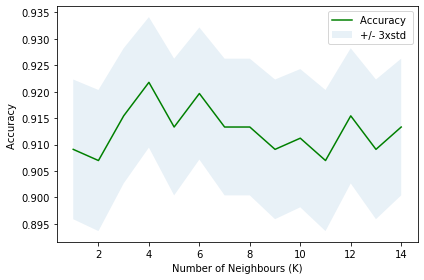

The best accuracy was with 0.9217758985200846 with k= 4


In [64]:
plt.plot(range(1,Ks),mean_acc,'g')
plt.fill_between(range(1,Ks),mean_acc - 1 * std_acc,mean_acc + 1 * std_acc, alpha=0.10)
plt.legend(('Accuracy ', '+/- 3xstd'))
plt.ylabel('Accuracy ')
plt.xlabel('Number of Neighbours (K)')
plt.tight_layout()
plt.show()
print( "The best accuracy was with", mean_acc.max(), "with k=", mean_acc.argmax()+1)

Train set: (1892, 4) (1892,)
Test set: (473, 4) (473,)
Train set Accuracy:  0.9133192389006343
Test set Accuracy:  0.9133192389006343


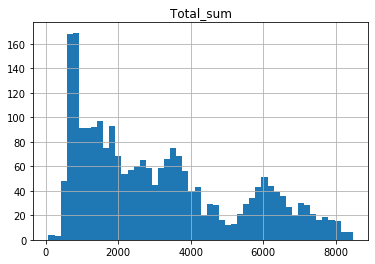

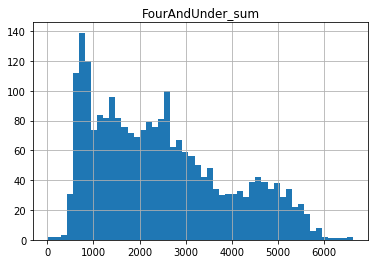

In [60]:

EmergWL['Type'].value_counts()

EmergWL.hist(column='Total_sum', bins=50)
EmergWL.hist(column='FourAndUnder_sum', bins=50)
EmergWL.columns

X = EmergWL[['FourAndUnder_sum', 'FiveToTwelve_sum', 'OverTwelve_sum', 'Total_sum']] .values #.astype(float)
X[0:5]

y = EmergWL['Type'].values
y[0:5]

X = preprocessing.StandardScaler().fit(X).transform(X.astype(float))
X[0:5]

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split( X, y, test_size=0.2, random_state=4)
print ('Train set:', X_train.shape,  y_train.shape)
print ('Test set:', X_test.shape,  y_test.shape)

from sklearn.neighbors import KNeighborsClassifier
k = 40
#Train Model and Predict  
neigh = KNeighborsClassifier(n_neighbors = k).fit(X_train,y_train)
neigh

yhat = neigh.predict(X_test)
yhat[0:5]

from sklearn import metrics
print("Train set Accuracy: ", metrics.accuracy_score(y_train, neigh.predict(X_train)))
print("Test set Accuracy: ", metrics.accuracy_score(y_test, yhat))



In [61]:
Ks = 15
mean_acc = np.zeros((Ks-1))
std_acc = np.zeros((Ks-1))
ConfustionMx = [];
for n in range(1,Ks):
    
    #Train Model and Predict  
    neigh = KNeighborsClassifier(n_neighbors = n).fit(X_train,y_train)
    yhat=neigh.predict(X_test)
    mean_acc[n-1] = metrics.accuracy_score(y_test, yhat)

    
    std_acc[n-1]=np.std(yhat==y_test)/np.sqrt(yhat.shape[0])

mean_acc

array([0.90909091, 0.90697674, 0.9154334 , 0.9217759 , 0.91331924,
       0.91966173, 0.91331924, 0.91331924, 0.90909091, 0.91120507,
       0.90697674, 0.9154334 , 0.90909091, 0.91331924])

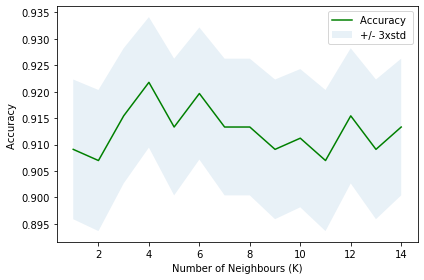

The best accuracy was with 0.9217758985200846 with k= 4


In [62]:
plt.plot(range(1,Ks),mean_acc,'g')
plt.fill_between(range(1,Ks),mean_acc - 1 * std_acc,mean_acc + 1 * std_acc, alpha=0.10)
plt.legend(('Accuracy ', '+/- 3xstd'))
plt.ylabel('Accuracy ')
plt.xlabel('Number of Neighbours (K)')
plt.tight_layout()
plt.show()
print( "The best accuracy was with", mean_acc.max(), "with k=", mean_acc.argmax()+1)

Train set: (1892, 4) (1892,)
Test set: (473, 4) (473,)
Train set Accuracy:  0.5972515856236786
Test set Accuracy:  0.5983086680761099


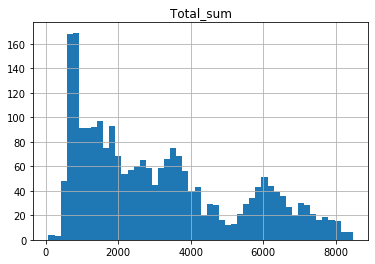

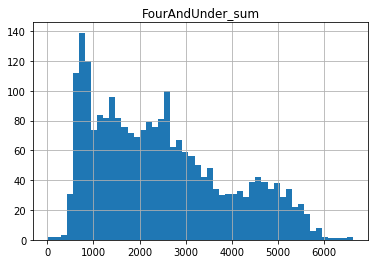

In [65]:

EmergWL['Trust'].value_counts()

EmergWL.hist(column='Total_sum', bins=50)
EmergWL.hist(column='FourAndUnder_sum', bins=50)
EmergWL.columns

X = EmergWL[['FourAndUnder_sum', 'FiveToTwelve_sum', 'OverTwelve_sum', 'Total_sum']] .values #.astype(float)
X[0:5]

y = EmergWL['Trust'].values
y[0:5]

X = preprocessing.StandardScaler().fit(X).transform(X.astype(float))
X[0:5]

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split( X, y, test_size=0.2, random_state=4)
print ('Train set:', X_train.shape,  y_train.shape)
print ('Test set:', X_test.shape,  y_test.shape)

from sklearn.neighbors import KNeighborsClassifier
k = 40
#Train Model and Predict  
neigh = KNeighborsClassifier(n_neighbors = k).fit(X_train,y_train)
neigh

yhat = neigh.predict(X_test)
yhat[0:5]

from sklearn import metrics
print("Train set Accuracy: ", metrics.accuracy_score(y_train, neigh.predict(X_train)))
print("Test set Accuracy: ", metrics.accuracy_score(y_test, yhat))



In [66]:
Ks = 15
mean_acc = np.zeros((Ks-1))
std_acc = np.zeros((Ks-1))
ConfustionMx = [];
for n in range(1,Ks):
    
    #Train Model and Predict  
    neigh = KNeighborsClassifier(n_neighbors = n).fit(X_train,y_train)
    yhat=neigh.predict(X_test)
    mean_acc[n-1] = metrics.accuracy_score(y_test, yhat)

    
    std_acc[n-1]=np.std(yhat==y_test)/np.sqrt(yhat.shape[0])

mean_acc

array([0.56659619, 0.54545455, 0.57716702, 0.59830867, 0.59830867,
       0.59408034, 0.61733615, 0.59196617, 0.60887949, 0.59830867,
       0.59830867, 0.60465116, 0.60887949, 0.60887949])

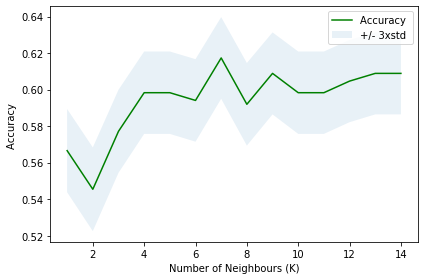

The best accuracy was with 0.6173361522198731 with k= 7


In [67]:
plt.plot(range(1,Ks),mean_acc,'g')
plt.fill_between(range(1,Ks),mean_acc - 1 * std_acc,mean_acc + 1 * std_acc, alpha=0.10)
plt.legend(('Accuracy ', '+/- 3xstd'))
plt.ylabel('Accuracy ')
plt.xlabel('Number of Neighbours (K)')
plt.tight_layout()
plt.show()
print( "The best accuracy was with", mean_acc.max(), "with k=", mean_acc.argmax()+1)

# Diagnostic Waiting List Analysis

In [ ]:
DiagnosticWT.head()

In [52]:
DiagnosticWT=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-diagnostic-waiting-times-q2-19-20.csv");DiagnosticWT=DiagnosticWT.drop_duplicates();DiagnosticWT.replace(".", 0, inplace=True);DiagnosticWT=DiagnosticWT.fillna(0);DiagnosticWT.drop(DiagnosticWT.columns[DiagnosticWT.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True);DiagnosticWT=DiagnosticWT.fillna(0);DiagnosticWT=DiagnosticWT.drop([8579,8623,8624,8625,8626]);DiagnosticWT.iloc[:, 5] = DiagnosticWT.iloc[:, 5].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 6] = DiagnosticWT.iloc[:, 6].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 7] = DiagnosticWT.iloc[:, 7].str.replace(",","").astype(float); DiagnosticWT.iloc[:, 8] = DiagnosticWT.iloc[:, 8].str.replace(",","").astype(float); DiagnosticWT.iloc[:, 10] = DiagnosticWT.iloc[:, 10].str.replace(",","").astype(float); DiagnosticWT.iloc[:, 11] = DiagnosticWT.iloc[:, 11].str.replace(",","").astype(float); DiagnosticWT.iloc[:, 12] = DiagnosticWT.iloc[:, 12].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 13] = DiagnosticWT.iloc[:, 13].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 14] = DiagnosticWT.iloc[:, 14].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 15] = DiagnosticWT.iloc[:, 15].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 16] = DiagnosticWT.iloc[:, 16].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 17] = DiagnosticWT.iloc[:, 17].str.replace(",","").astype(float);DiagnosticWT.fillna(0);
DiagnosticRTT=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-diagnostic-reporting-turnaround-q2-19-20.csv");DiagnosticRTT=DiagnosticRTT.drop_duplicates();DiagnosticRTT.replace(".", 0, inplace=True);DiagnosticRTT=DiagnosticRTT.fillna(0);DiagnosticRTT=DiagnosticRTT.drop([9947]);DiagnosticRTT.drop(DiagnosticRTT.columns[DiagnosticRTT.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True);DiagnosticRTT["0-2 days"] = DiagnosticRTT["0-2 days"].str.replace(",","").astype(int);DiagnosticRTT["3-7 days"] = DiagnosticRTT["3-7 days"].str.replace(",","").astype(int);DiagnosticRTT["8-14 days"] = DiagnosticRTT["8-14 days"].str.replace(",","").astype(int);DiagnosticRTT["15-21 days"] = DiagnosticRTT["15-21 days"].str.replace(",","").astype(int);DiagnosticRTT["22-28 days"] = DiagnosticRTT["22-28 days"].str.replace(",","").astype(int);DiagnosticRTT[">28 days	"] = DiagnosticRTT[">28 days"].str.replace(",","").astype(int);DiagnosticRTT["Total"] = DiagnosticRTT["Total"].str.replace(",","").astype(int)
DiagnosticRTT.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9947 entries, 0 to 9946
Data columns (total 16 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Month                      9947 non-null   object 
 1   HSC Trust                  9947 non-null   object 
 2   Category of test           9947 non-null   object 
 3   Test                       9947 non-null   object 
 4   Priority                   9947 non-null   object 
 5   0-2 days                   9947 non-null   int32  
 6   3-7 days                   9947 non-null   int32  
 7   8-14 days                  9947 non-null   int32  
 8   15-21 days                 9947 non-null   int32  
 9   22-28 days                 9947 non-null   int32  
 10  >28 days                   9947 non-null   object 
 11  Total                      9947 non-null   int32  
 12  % reported within 2 days   9947 non-null   float64
 13  % reported within 2 weeks  9947 non-null   float

In [33]:
DiagnosticWT.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8579 entries, 0 to 8578
Data columns (total 18 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Quarter Ending            8579 non-null   object 
 1   HSC Trust                 8579 non-null   object 
 2   Diagnostic Service        8579 non-null   object 
 3   Recommended Waiting Time  8579 non-null   object 
 4   Category                  8579 non-null   object 
 5   0 - 6 weeks               8579 non-null   float64
 6   > 6 - 9 weeks             8579 non-null   float64
 7   > 9 - 13 weeks            8579 non-null   float64
 8   > 13 - 21 weeks           8579 non-null   float64
 9   > 21 - 26 weeks           8579 non-null   float64
 10  > 26 weeks                8579 non-null   float64
 11  > 26 - 36 weeks           1070 non-null   float64
 12  > 36 weeks                8579 non-null   float64
 13  > 36 - 52 weeks           1070 non-null   float64
 14  > 52 - 6

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x0000028C9A544D48>]],
      dtype=object)

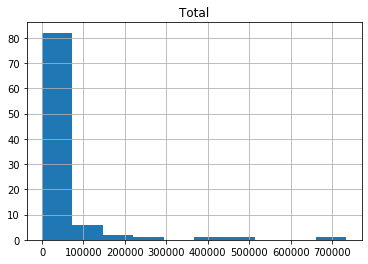

In [34]:
A=DiagnosticWT.groupby('Diagnostic Service').sum()
B=DiagnosticWT.groupby('Category').sum()
C=DiagnosticWT.groupby('Recommended Waiting Time').sum()
C
#x=A["0-6 weeks"]
#y=A["Total"]
A.hist(column='Total', bins=10)
#plt.scatter(x, y, s=area, c=colors, alpha=0.5)
#plt.show()
#.hist(column='0 - 6 weeks', bins=150)
#EmergWL.hist(column='FourAndUnder_sum', bins=50)
#A.plot.bar()

In [35]:
#DiagnosticWT.column()

In [36]:
DiagnosticWT=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-diagnostic-waiting-times-q2-19-20.csv");DiagnosticWT=DiagnosticWT.drop_duplicates();DiagnosticWT.replace(".", 0, inplace=True);DiagnosticWT=DiagnosticWT.fillna(0);DiagnosticWT.drop(DiagnosticWT.columns[DiagnosticWT.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True);DiagnosticWT=DiagnosticWT.fillna(0);DiagnosticWT=DiagnosticWT.drop([8579,8623,8624,8625,8626]);DiagnosticWT.iloc[:, 5] = DiagnosticWT.iloc[:, 5].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 6] = DiagnosticWT.iloc[:, 6].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 7] = DiagnosticWT.iloc[:, 7].str.replace(",","").astype(float); DiagnosticWT.iloc[:, 8] = DiagnosticWT.iloc[:, 8].str.replace(",","").astype(float); DiagnosticWT.iloc[:, 10] = DiagnosticWT.iloc[:, 10].str.replace(",","").astype(float); DiagnosticWT.iloc[:, 11] = DiagnosticWT.iloc[:, 11].str.replace(",","").astype(float); DiagnosticWT.iloc[:, 12] = DiagnosticWT.iloc[:, 12].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 13] = DiagnosticWT.iloc[:, 13].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 14] = DiagnosticWT.iloc[:, 14].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 15] = DiagnosticWT.iloc[:, 15].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 16] = DiagnosticWT.iloc[:, 16].str.replace(",","").astype(float);DiagnosticWT.iloc[:, 17] = DiagnosticWT.iloc[:, 17].str.replace(",","").astype(float);DiagnosticWT.fillna(0);

df=DiagnosticWT
df['Below 9 weeks'] = df["> 6 - 9 weeks"] + df["0 - 6 weeks"]
df['% Below 9 weeks'] = 100*df['Below 9 weeks'].divide(df["Total"], fill_value=1)
df['Below 13 weeks'] = df["> 9 - 13 weeks"] + df['Below 9 weeks']
df['% Below 13 weeks']= 100*df['Below 13 weeks'].divide(df["Total"], fill_value=1) 
df=df.drop(df.columns[[5,6,7,8,9,10,11,12]], axis = 1, inplace = False) 
df2=df.dropna(axis='columns')
df2['Below Recommended'] = np.where(df2["Recommended Waiting Time"] == "9 week", df['% Below 9 weeks'],df['% Below 13 weeks'])
df2



# Visualize pairplot of df

#df2.head()
#df.info()
#df.list()
#plt.figure(figsize=(8,5))
#x_data, y_data = (df2['% Below 9 weeks'].values, HSCT31DCWT['% Below 13 weeks'].values)
#plt.plot(x_data, y_data,'ro')
#plt.ylabel('62 days')
#plt.xlabel('31 days')
#plt.show()

C:\Users\Pat\anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Quarter Ending,HSC Trust,Diagnostic Service,Recommended Waiting Time,Category,Total,Below 9 weeks,% Below 9 weeks,Below 13 weeks,% Below 13 weeks,Below Recommended
0,31-Mar-08,Belfast,Barium Studies,9 week,Imaging,316.0,256.0,81.012658,316.0,100.000000,81.012658
1,31-Mar-08,Belfast,Colonoscopy,13 week,Endoscopy,667.0,269.0,40.329835,539.0,80.809595,80.809595
2,31-Mar-08,Belfast,Computerised Tomography,9 week,Imaging,1253.0,907.0,72.386273,1253.0,100.000000,72.386273
3,31-Mar-08,Belfast,Cystoscopy,13 week,Endoscopy,789.0,371.0,47.021546,629.0,79.721166,79.721166
4,31-Mar-08,Belfast,DEXA Scan,9 week,Imaging,606.0,281.0,46.369637,606.0,100.000000,46.369637
...,...,...,...,...,...,...,...,...,...,...,...
8574,30-Sep-19,Western,Spirometry inc.flow volume curves,9 week,Physiological Measurement,94.0,86.0,91.489362,94.0,100.000000,91.489362
8575,30-Sep-19,Western,Static lung volumes,9 week,Physiological Measurement,79.0,71.0,89.873418,79.0,100.000000,89.873418
8576,30-Sep-19,Western,Tilt testing and autonomic function,9 week,Physiological Measurement,18.0,10.0,55.555556,14.0,77.777778,55.555556
8577,30-Sep-19,Western,Transfer Factor,9 week,Physiological Measurement,92.0,84.0,91.304348,92.0,100.000000,91.304348


In [39]:

DiagnosticRTT['Month']=pd.to_datetime(DiagnosticRTT['Month'])
DiagnosticRTT.head()

,Month,HSC Trust,Category of test,Test,Priority,0-2 days,3-7 days,8-14 days,15-21 days,22-28 days,>28 days,Total,% reported within 2 days,% reported within 2 weeks,% reported within 4 weeks,>28 days\t
0,2010-10-31,Belfast,IMAGING,BARIUM ENEMA,ROUTINE,88,9,4,1,15,5,122,0.0,82.8,95.9,5
1,2010-10-31,Belfast,IMAGING,BARIUM ENEMA,URGENT,9,3,0,0,0,0,12,75.0,0.0,0.0,0
2,2010-10-31,Belfast,IMAGING,COMPUTERISED TOMOGRAPHY,ROUTINE,1521,218,83,7,127,31,1987,0.0,91.7,98.4,31
3,2010-10-31,Belfast,IMAGING,COMPUTERISED TOMOGRAPHY,URGENT,279,43,18,2,10,4,356,78.4,0.0,0.0,4
4,2010-10-31,Belfast,IMAGING,DEXA SCAN,ROUTINE,0,0,1,2,1,6,10,0.0,10.0,40.0,6


C:\Users\Pat\anaconda3\lib\site-packages\ipykernel_launcher.py:2: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.

C:\Users\Pat\anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



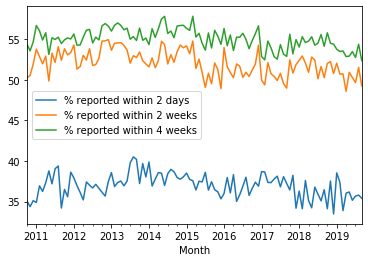

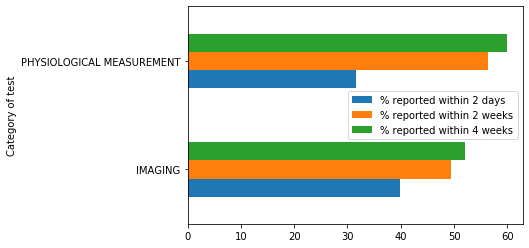

In [40]:
#df3['Quarter Ending']=pd.to_datetime(df3['Quarter Ending'])
P=DiagnosticRTT.groupby('Month')["% reported within 2 days","% reported within 2 weeks","% reported within 4 weeks"].mean()
P.plot.line()
Q=DiagnosticRTT.groupby('Category of test')["% reported within 2 days","% reported within 2 weeks","% reported within 4 weeks"].mean()
Q.plot.barh()

C:\Users\Pat\anaconda3\lib\site-packages\ipykernel_launcher.py:6: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.

C:\Users\Pat\anaconda3\lib\site-packages\ipykernel_launcher.py:8: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



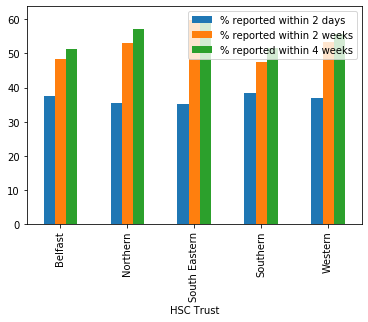

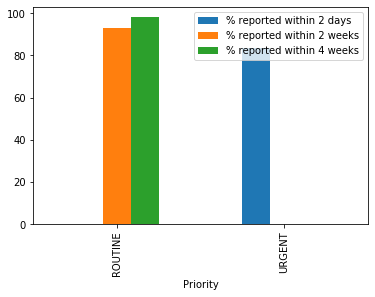

In [41]:
#DiagnosticRTT.head()

#R=DiagnosticRTT.groupby('Test')["% reported within 2 days","% reported within 2 weeks","% reported within 4 weeks"].mean()
#R.plot.barh()
#R.plot.kde()
S=DiagnosticRTT.groupby('HSC Trust')["% reported within 2 days","% reported within 2 weeks","% reported within 4 weeks"].mean()
S.plot.bar()
T=DiagnosticRTT.groupby('Priority')["% reported within 2 days","% reported within 2 weeks","% reported within 4 weeks"].mean()
T.plot.bar()



## Clean the Inpatient and Outpatient lists

In [479]:
FirstCOPWL = pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-outpatients-q2-19-20.csv")
#Remove footer data
FirstCOPWL=FirstCOPWL.drop([6134,6135,6136,6137,6138]);
FirstCOPWL.dropna(axis='columns')
FirstCOPWL = FirstCOPWL.fillna(0)
FirstCOPWL.iloc[:, 1] = FirstCOPWL.iloc[:, 1].str.replace(" ","");
FirstCOPWL.iloc[:, 1] = FirstCOPWL.iloc[:, 1].str.replace("SouthEastern","South Eastern");
FirstCOPWL.iloc[:, 1] = FirstCOPWL.iloc[:, 1].str.replace("RegionalAssessmentandSurgicalCentre","RASC");
FirstCOPWL.iloc[:, 4] = FirstCOPWL.iloc[:, 4].str.replace(",","");FirstCOPWL.iloc[:, 4] = FirstCOPWL.iloc[:, 4].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 5] = FirstCOPWL.iloc[:, 5].str.replace(",","");FirstCOPWL.iloc[:, 5] = FirstCOPWL.iloc[:, 5].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 6] = FirstCOPWL.iloc[:, 6].str.replace(",","");FirstCOPWL.iloc[:, 6] = FirstCOPWL.iloc[:, 6].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 7] = FirstCOPWL.iloc[:, 7].str.replace(",","");FirstCOPWL.iloc[:, 7] = FirstCOPWL.iloc[:, 7].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 8] = FirstCOPWL.iloc[:, 8].str.replace(",","");FirstCOPWL.iloc[:, 8] = FirstCOPWL.iloc[:, 8].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 9] = FirstCOPWL.iloc[:, 9].str.replace(",","");FirstCOPWL.iloc[:, 9] = FirstCOPWL.iloc[:, 9].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 10] = FirstCOPWL.iloc[:, 10].str.replace(",","");FirstCOPWL.iloc[:, 10] = FirstCOPWL.iloc[:, 10].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 11] = FirstCOPWL.iloc[:, 11].str.replace(",","");FirstCOPWL.iloc[:, 11] = FirstCOPWL.iloc[:, 11].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 12] = FirstCOPWL.iloc[:, 12].str.replace(",","");FirstCOPWL.iloc[:, 12] = FirstCOPWL.iloc[:, 12].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 13] = FirstCOPWL.iloc[:, 13].str.replace(",","");FirstCOPWL.iloc[:, 13] = FirstCOPWL.iloc[:, 13].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 14] = FirstCOPWL.iloc[:, 14].str.replace(",","");FirstCOPWL.iloc[:, 14] = FirstCOPWL.iloc[:, 14].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 15] = FirstCOPWL.iloc[:, 15].str.replace(",","");FirstCOPWL.iloc[:, 15] = FirstCOPWL.iloc[:, 15].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 16] = FirstCOPWL.iloc[:, 16].str.replace(",","");FirstCOPWL.iloc[:, 16] = FirstCOPWL.iloc[:, 16].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 17] = FirstCOPWL.iloc[:, 17].str.replace(",","");FirstCOPWL.iloc[:, 17] = FirstCOPWL.iloc[:, 17].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 18] = FirstCOPWL.iloc[:, 18].str.replace(",","");FirstCOPWL.iloc[:, 18] = FirstCOPWL.iloc[:, 18].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 19] = FirstCOPWL.iloc[:, 19].str.replace(",","");FirstCOPWL.iloc[:, 19] = FirstCOPWL.iloc[:, 19].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 20] = FirstCOPWL.iloc[:, 20].str.replace(",","");FirstCOPWL.iloc[:, 20] = FirstCOPWL.iloc[:, 20].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 21] = FirstCOPWL.iloc[:, 21].str.replace(",","");FirstCOPWL.iloc[:, 21] = FirstCOPWL.iloc[:, 21].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 22] = FirstCOPWL.iloc[:, 22].str.replace(",","");FirstCOPWL.iloc[:, 22] = FirstCOPWL.iloc[:, 22].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 23] = FirstCOPWL.iloc[:, 23].str.replace(",","");FirstCOPWL.iloc[:, 23] = FirstCOPWL.iloc[:, 23].str.replace("--","0").astype(int);
FirstCOPWL = FirstCOPWL.infer_objects();
FirstCOPWL['Below 26 weeks']= FirstCOPWL.iloc[:, 4:10].sum(axis=1) + FirstCOPWL.iloc[:, 20];
FirstCOPWL['% Below 26 weeks'] = 100*FirstCOPWL['Below 26 weeks'].divide(FirstCOPWL["Total Waiting "], fill_value=1);
FirstCOPWL['% Above 26 weeks'] = 100 - FirstCOPWL['% Below 26 weeks']
FirstCOPWL.drop(FirstCOPWL.columns[[4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24]], axis = 1, inplace = True)
FirstCOPWL.info()


CentralCOPWL = pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-outpatients-centralisation-q2-19-20.csv")
#Remove footer data
CentralCOPWL=CentralCOPWL.drop([66,67,68,69,70,71]);CentralCOPWL=CentralCOPWL.dropna(axis='columns')
#OrigCCOPWL=CentralCOPWL
CentralCOPWL.replace("--", 0, inplace=True)
CentralCOPWL.iloc[:, 9] = CentralCOPWL.iloc[:, 9].str.replace(",","").astype(float); 
CentralCOPWL.iloc[:, 10] = CentralCOPWL.iloc[:, 10].str.replace(",","").astype(float); 
CentralCOPWL.iloc[:, 11] = CentralCOPWL.iloc[:, 11].str.replace(",","").astype(float); 
CentralCOPWL.iloc[:, 12] = CentralCOPWL.iloc[:, 12].str.replace(",","").astype(float); 
#CentralCOPWL["Total Waiting "] = CentralCOPWL["Total Waiting "].str.replace(",","").astype(float)
#CentralCOPWL[" > 18 weeks "] = CentralCOPWL[" > 18 weeks "].astype(float)
#CentralCOPWL['Below 18 weeks']= CentralCOPWL.iloc[:, 4:9].sum(axis=1)
#CentralCOPWL['Below 18 weeksB']= CentralCOPWL.iloc[:, 4:9].sum(axis=1)

#CentralCOPWL.drop(CentralCOPWL.columns[[4,5,6,7,8,9,10,11]], axis = 1, inplace = True) 
#CentralCOPWL['Above 18 weeks']= CentralCOPWL.iloc[:,-2:-1].subtract(axis=1)
#CentralCOPWL.drop(columns =["Treatment Month"], inplace = True) 
#CentralCOPWL['Above 18 weeks'] = CentralCOPWL['Total Waiting '].sub(CentralCOPWL['Below 18 weeks'], axis = 0) 
CentralCOPWL

ICATSWL=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-icats-q2-19-20.csv")
ICATSWLA=ICATSWL.drop_duplicates();ICATSWL=ICATSWLA.drop([689,691,692,693,694]);ICATSWL=ICATSWL.dropna(axis='columns');ICATSWL=ICATSWL.fillna(0)
ICATSWL.replace("--", 0, inplace=True)
ICATSWL = ICATSWL.infer_objects()
ICATSWL.iloc[:, 4] = ICATSWL.iloc[:, 4].str.replace(",","").astype(float); ICATSWL.iloc[:, 6] = ICATSWL.iloc[:, 6].str.replace(",","").astype(float);ICATSWL.iloc[:, 7] = ICATSWL.iloc[:, 7].str.replace(",","").astype(float); ICATSWL.iloc[:, 8] = ICATSWL.iloc[:, 8].str.replace(",","").astype(float); ICATSWL.iloc[:, 9] = ICATSWL.iloc[:, 9].str.replace(",","").astype(float); ICATSWL.iloc[:, 10] = ICATSWL.iloc[:, 10].str.replace(",","").astype(float); ICATSWL.iloc[:, 11] = ICATSWL.iloc[:, 11].str.replace(",","").astype(float); ICATSWL.iloc[:, 12] = ICATSWL.iloc[:, 12].str.replace(",","").astype(float); ICATSWL.iloc[:, 13] = ICATSWL.iloc[:, 13].str.replace(",","").astype(float);ICATSWL=ICATSWL.fillna(0)
ICATSWL['Quarter Ending']=pd.to_datetime(ICATSWL['Quarter Ending'])
ICATSWL
#Remove footer data

DayCaseIPWL=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-day-cases-q2-19-20.csv")
DayCaseIPWL.replace("--", 0, inplace=True)
#Remove footer data
DayCaseIPWL=DayCaseIPWL.drop([4399,4400,4401,4402,4403,4404,4405,4406,4407,4408,4409,4410,4411,4412]);DayCaseIPWL.drop(DayCaseIPWL.columns[DayCaseIPWL.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True);DayCaseIPWL.replace("--", 0, inplace=True);DayCaseIPWL.fillna(0)
DayCaseIPWL=DayCaseIPWL.dropna(axis='columns');DayCaseIPWL=DayCaseIPWL.fillna(0);DayCaseIPWL.iloc[:, 4] = DayCaseIPWL.iloc[:, 4].str.replace(",","").astype(float);DayCaseIPWL.iloc[:, 5] = DayCaseIPWL.iloc[:, 5].str.replace(",","").astype(float);DayCaseIPWL.iloc[:, 6] = DayCaseIPWL.iloc[:, 6].str.replace(",","").astype(float);DayCaseIPWL.iloc[:, 8] = DayCaseIPWL.iloc[:, 8].str.replace(",","").astype(float);


AdminIPWL=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-inpatients-q2-19-20.csv")
#Remove footer data
AdminIPWL=AdminIPWL.drop([2994,2995,2996,2997,2998,2999,3000,3001,3002,3003,3004,3005]);AdminIPWL=AdminIPWL.dropna(axis='columns');AdminIPWL=AdminIPWL.fillna(0);AdminIPWL.drop(AdminIPWL.columns[AdminIPWL.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True)
AdminIPWL.replace("--", 0, inplace=True)
AdminIPWL["0 - 6 weeks"] = AdminIPWL["Total"].str.replace(",","").astype(int);AdminIPWL["> 6 - 13 weeks"] = AdminIPWL["> 6 - 13 weeks"].str.replace(",","").astype(int);AdminIPWL["> 13 - 21 weeks"] = AdminIPWL["> 13 - 21 weeks"].str.replace(",","").astype(int);AdminIPWL["> 21 - 26 weeks"] = AdminIPWL["> 21 - 26 weeks"].str.replace(",","").astype(int);AdminIPWL["Total"] = AdminIPWL["Total"].str.replace(",","").astype(int)
AdminIPWL=AdminIPWL.dropna(axis='columns')

TotalIPWL=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-total-waiting-q2-19-20.csv");TotalIPWL=TotalIPWL.drop([4550,4551,4552,4553,4554,4555,4556,4557,4558,4559,4560,4561]);TotalIPWL=TotalIPWL.fillna(0);TotalIPWL.drop(TotalIPWL.columns[TotalIPWL.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True);TotalIPWL["Total"] = TotalIPWL["Total"].str.replace(",","").astype(int)
TotalIPWL.replace("--", 0, inplace=True)
TotalIPWL.iloc[:, 4] = TotalIPWL.iloc[:, 4].str.replace(",","").astype(float); TotalIPWL.iloc[:, 5] = TotalIPWL.iloc[:, 5].str.replace(",","").astype(float); TotalIPWL.iloc[:, 7] = TotalIPWL.iloc[:, 7].str.replace(",","").astype(float); TotalIPWL.iloc[:, 8] = TotalIPWL.iloc[:, 8].str.replace(",","").astype(float); TotalIPWL.iloc[:, 9] = TotalIPWL.iloc[:, 9].str.replace(",","").astype(float); TotalIPWL.iloc[:, 6] = TotalIPWL.iloc[:, 6].str.replace(",","").astype(float); TotalIPWL.iloc[:, 10] = TotalIPWL.iloc[:, 10].str.replace(",","").astype(float); TotalIPWL.iloc[:, 11] = TotalIPWL.iloc[:, 11].str.replace(",","").astype(float); TotalIPWL.iloc[:, 13] = TotalIPWL.iloc[:, 13].str.replace(",","").astype(float); TotalIPWL.iloc[:, 14] = TotalIPWL.iloc[:, 14].str.replace(",","").astype(float);TotalIPWL.iloc[:, 15] = TotalIPWL.iloc[:, 15].str.replace(",","").astype(float); 
TotalIPWL=TotalIPWL.dropna(axis='columns')
TotalIPWL=TotalIPWL.fillna(0)
#TotalIPWL.iloc[:, 12] = TotalIPWL.iloc[:, 11].str.replace(",","").astype(float); 

TotalIPWL=TotalIPWL.fillna(0)
TotalIPWL['Below 26 weeks']= TotalIPWL.iloc[:, 4:8].sum(axis=1);
TotalIPWL['% Below 26 weeks'] = 100*TotalIPWL['Below 26 weeks'].divide(TotalIPWL["Total"], fill_value=1)
TotalIPWL['% Above 26 weeks'] = 100-100*TotalIPWL['Below 26 weeks'].divide(TotalIPWL["Total"], fill_value=1)


#TotalIPWL.info()
#TotalIPWL.iloc[:, 5] = TotalIPWL.iloc[:, 5].astype(float);
#TotalIPWL.iloc[:, 7] = TotalIPWL.iloc[:, 7].astype(float); 
#TotalIPWL.iloc[:, 8] = TotalIPWL.iloc[:, 8].astype(float); 
#TotalIPWL.iloc[:, 9] = TotalIPWL.iloc[:, 9].astype(float);
#TotalIPWL.iloc[:, 10] = TotalIPWL.iloc[:, 10].astype(float);
#TotalIPWL.iloc[:, 11] = TotalIPWL.iloc[:, 11].astype(float); 
#TotalIPWL.iloc[:, 12] = TotalIPWL.iloc[:, 12].astype(float); 
#TotalIPWL.iloc[:, 13] = TotalIPWL.iloc[:, 13].astype(float);
#TotalIPWL.iloc[:, 14] = TotalIPWL.iloc[:, 14].str.replace("0",0)
#.astype(float); 
#TotalIPWL.iloc[:, 15] = TotalIPWL.iloc[:, 15].astype(float);
#TotalIPWL.iloc[:, 16] = TotalIPWL.iloc[:, 16].astype(float);

print("All In and Out Patient Data Imported")

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6134 entries, 0 to 6133
Data columns (total 6 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Quarter Ending     6134 non-null   object 
 1   HSC Trust          6134 non-null   object 
 2   Specialty          6134 non-null   object 
 3   Programme of Care  6134 non-null   object 
 4   % Below 26 weeks   6134 non-null   float64
 5   % Above 26 weeks   6134 non-null   float64
dtypes: float64(2), object(4)
memory usage: 335.5+ KB
All In and Out Patient Data Imported


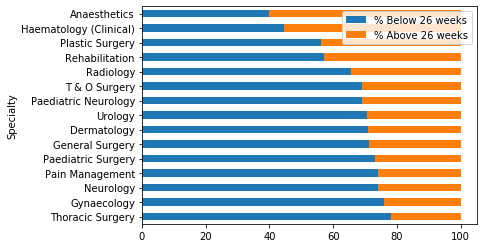

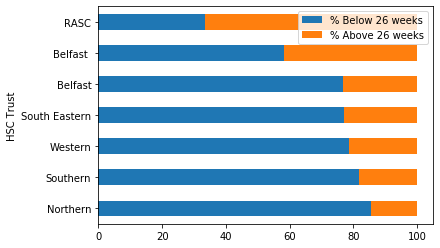

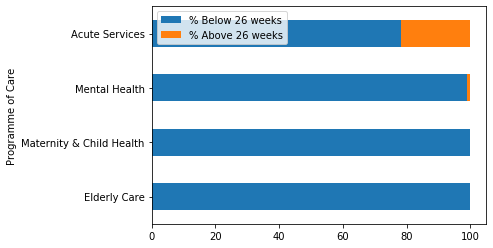

In [351]:
import pandas as pd
AdminIPWL=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-inpatients-q2-19-20.csv")
#Remove footer data
AdminIPWL=AdminIPWL.drop([2994,2995,2996,2997,2998,2999,3000,3001,3002,3003,3004,3005]);AdminIPWL=AdminIPWL.dropna(axis='columns');AdminIPWL=AdminIPWL.fillna(0);AdminIPWL.drop(AdminIPWL.columns[AdminIPWL.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True)
AdminIPWL.replace("--", 0, inplace=True)
AdminIPWL["0 - 6 weeks"] = AdminIPWL["0 - 6 weeks"].str.replace(",","").astype(int);AdminIPWL["> 6 - 13 weeks"] = AdminIPWL["> 6 - 13 weeks"].str.replace(",","").astype(int);AdminIPWL["> 13 - 21 weeks"] = AdminIPWL["> 13 - 21 weeks"].str.replace(",","").astype(int);AdminIPWL["> 21 - 26 weeks"] = AdminIPWL["> 21 - 26 weeks"].str.replace(",","").astype(int);AdminIPWL["Total"] = AdminIPWL["Total"].str.replace(",","").astype(int)
AdminIPWL=AdminIPWL.dropna(axis='columns')
AdminIPWL['Below 26 weeks']= AdminIPWL.iloc[:, 4:7].sum(axis=1);
AdminIPWL['% Below 26 weeks'] = 100*AdminIPWL['Below 26 weeks'].divide(AdminIPWL["Total"], fill_value=1).astype(float)
AdminIPWL['% Above 26 weeks'] = 100-100*AdminIPWL['Below 26 weeks'].divide(AdminIPWL["Total"], fill_value=1).astype(float)
AdminIPWL=AdminIPWL.drop(AdminIPWL.columns[[4,5,6,7,8,9]], axis = 1, inplace = False) 

AdminIPWL.head()
#A=AdminIPWL.groupby(['Quarter Ending'])["% Below 18 weeks","% Above 18 weeks"].mean()
#A.plot.line()
B=AdminIPWL.groupby(['Specialty']).mean()
B = B.sort_values(by ='% Above 26 weeks' )
B.tail(15).plot.barh(stacked=True)
#AdminIPWL.head()

C=AdminIPWL.groupby(['HSC Trust']).mean()
C = C.sort_values(by ='% Above 26 weeks' )

C.plot.barh(stacked=True)

D=AdminIPWL.groupby(['Programme of Care']).mean()
D = D.sort_values(by ='% Above 26 weeks' )

D.plot.barh(stacked=True)

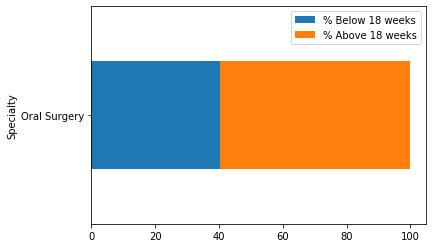

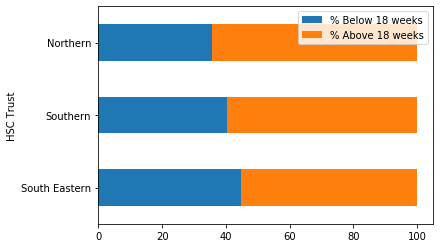

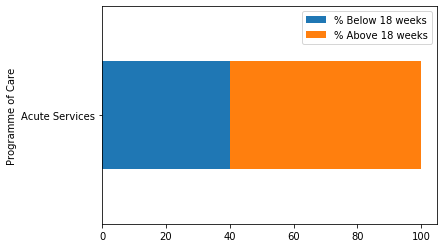

In [480]:
CentralCOPWL = pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-outpatients-centralisation-q2-19-20.csv")
#Remove footer data
CentralCOPWL=CentralCOPWL.drop([66,67,68,69,70,71]);CentralCOPWL=CentralCOPWL.dropna(axis='columns')
#OrigCCOPWL=CentralCOPWL
CentralCOPWL.replace("--", 0, inplace=True)
CentralCOPWL.iloc[:, 9] = CentralCOPWL.iloc[:, 9].str.replace(",","").astype(float); 
CentralCOPWL.iloc[:, 10] = CentralCOPWL.iloc[:, 10].str.replace(",","").astype(float); 
CentralCOPWL.iloc[:, 11] = CentralCOPWL.iloc[:, 11].str.replace(",","").astype(float); 
CentralCOPWL.iloc[:, 12] = CentralCOPWL.iloc[:, 12].str.replace(",","").astype(float); 
CentralCOPWL['Below 18 weeks']= CentralCOPWL.iloc[:, 4:9].sum(axis=1);
CentralCOPWL['% Below 18 weeks'] = 100*CentralCOPWL['Below 18 weeks'].divide(CentralCOPWL['Total Waiting '], fill_value=1).astype(float)
CentralCOPWL['% Above 18 weeks'] = 100- CentralCOPWL['% Below 18 weeks'];
CentralCOPWL=CentralCOPWL.drop(CentralCOPWL.columns[[4,5,6,7,8,9,10,11,12,13]], axis = 1, inplace = False) 
CentralCOPWL['Quarter Ending']=pd.to_datetime(CentralCOPWL['Quarter Ending'])

CentralCOPWL=CentralCOPWL.fillna(0)


#CentralCOPWL['Below 18 weeks']= CentralCOPWL.iloc[:, 4:9].sum(axis=1)

CentralCOPWL.head()
#df=
B=CentralCOPWL.groupby(['Specialty']).mean()
B = B.sort_values(by ='% Above 18 weeks' )
B.tail(15).plot.barh(stacked=True)
#AdminIPWL.head()

C=CentralCOPWL.groupby(['HSC Trust']).mean()
C = C.sort_values(by ='% Above 18 weeks' )

C.plot.barh(stacked=True)

D=CentralCOPWL.groupby(['Programme of Care']).mean()
D = D.sort_values(by ='% Above 18 weeks' )

D.plot.barh(stacked=True)

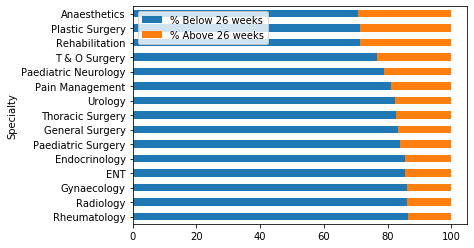

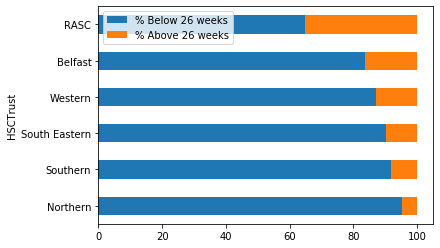

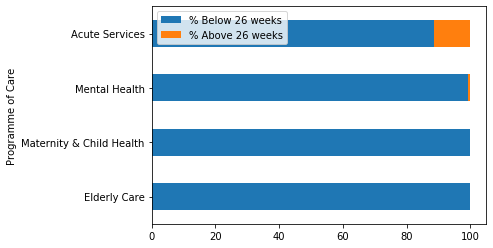

In [302]:
TotalIPWL=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-total-waiting-q2-19-20.csv");TotalIPWL=TotalIPWL.drop([4550,4551,4552,4553,4554,4555,4556,4557,4558,4559,4560,4561]);TotalIPWL=TotalIPWL.fillna(0);TotalIPWL.drop(TotalIPWL.columns[TotalIPWL.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True);TotalIPWL["Total"] = TotalIPWL["Total"].str.replace(",","").astype(int)
TotalIPWL.replace("--", 0, inplace=True)
TotalIPWL.iloc[:, 4] = TotalIPWL.iloc[:, 4].str.replace(",","").astype(float); TotalIPWL.iloc[:, 5] = TotalIPWL.iloc[:, 5].str.replace(",","").astype(float); TotalIPWL.iloc[:, 7] = TotalIPWL.iloc[:, 7].str.replace(",","").astype(float); TotalIPWL.iloc[:, 8] = TotalIPWL.iloc[:, 8].str.replace(",","").astype(float); TotalIPWL.iloc[:, 9] = TotalIPWL.iloc[:, 9].str.replace(",","").astype(float); TotalIPWL.iloc[:, 6] = TotalIPWL.iloc[:, 6].str.replace(",","").astype(float); TotalIPWL.iloc[:, 10] = TotalIPWL.iloc[:, 10].str.replace(",","").astype(float); TotalIPWL.iloc[:, 11] = TotalIPWL.iloc[:, 11].str.replace(",","").astype(float); TotalIPWL.iloc[:, 13] = TotalIPWL.iloc[:, 13].str.replace(",","").astype(float); TotalIPWL.iloc[:, 14] = TotalIPWL.iloc[:, 14].str.replace(",","").astype(float);TotalIPWL.iloc[:, 15] = TotalIPWL.iloc[:, 15].str.replace(",","").astype(float); 
TotalIPWL=TotalIPWL.dropna(axis='columns')
TotalIPWL=TotalIPWL.fillna(0)
#TotalIPWL.iloc[:, 12] = TotalIPWL.iloc[:, 11].str.replace(",","").astype(float); 

TotalIPWL=TotalIPWL.fillna(0)
TotalIPWL['Below 26 weeks']= TotalIPWL.iloc[:, 4:8].sum(axis=1);
TotalIPWL['% Below 26 weeks'] = 100*TotalIPWL['Below 26 weeks'].divide(TotalIPWL["Total"], fill_value=1)
TotalIPWL['% Above 26 weeks'] = 100-100*TotalIPWL['Below 26 weeks'].divide(TotalIPWL["Total"], fill_value=1)
TotalIPWL=TotalIPWL.drop(TotalIPWL.columns[[4,5,6,7,8,9,10]], axis = 1, inplace = False) 
B=TotalIPWL.groupby(['Specialty']).mean()

B = B.sort_values(by ='% Above 26 weeks' )
B.tail(15).plot.barh(stacked=True)

C=TotalIPWL.groupby(['HSCTrust']).mean()
C = C.sort_values(by ='% Above 26 weeks' )
#C = B.sort_values(by ='% Above 26 weeks' )
C.plot.barh(stacked=True)

D=TotalIPWL.groupby(['Programme of Care']).mean()
D = D.sort_values(by ='% Above 26 weeks' )
#C = B.sort_values(by ='% Above 26 weeks' )
D.plot.barh(stacked=True)


#A=TotalIPWL.groupby(['Quarter Ending'])["% Below 26 weeks","% Above 26 weeks"].mean()
#A.plot.line()
#B.tail(20).plot.barh(stacked=True)
#["% Below 18 weeks","% Above 18 weeks"]
#B.plot.barh()
#CentralCOPWL.info()
#TotalIPWL.head()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 66 entries, 0 to 65
Data columns (total 9 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   Quarter Ending     66 non-null     datetime64[ns]
 1   HSC Trust          66 non-null     object        
 2   Specialty          66 non-null     object        
 3   Programme of Care  66 non-null     object        
 4   Total Waiting      66 non-null     float64       
 5   Below 18 weeks     66 non-null     float64       
 6   Above 18 weeks     66 non-null     float64       
 7   % Below 18 weeks   66 non-null     float64       
 8   % Above 18 weeks   66 non-null     float64       
dtypes: datetime64[ns](1), float64(5), object(3)
memory usage: 5.2+ KB


C:\Users\Pat\anaconda3\lib\site-packages\ipykernel_launcher.py:9: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.

C:\Users\Pat\anaconda3\lib\site-packages\ipykernel_launcher.py:13: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.

C:\Users\Pat\anaconda3\lib\site-packages\ipykernel_launcher.py:16: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.

C:\Users\Pat\anaconda3\lib\site-packages\ipykernel_launcher.py:19: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



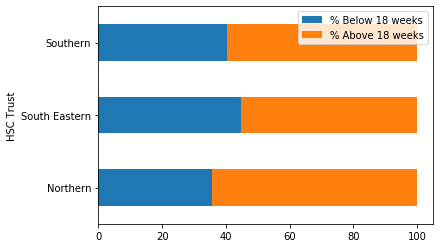

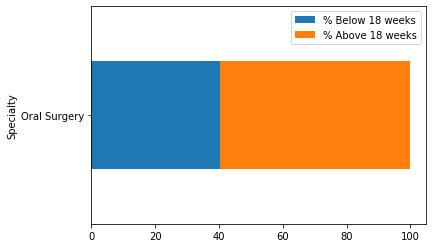

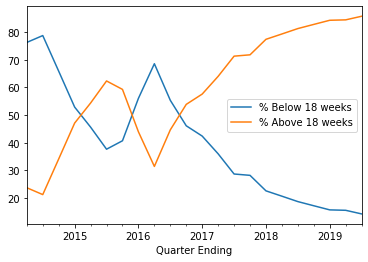

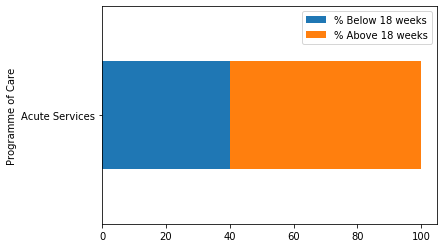

In [266]:
import pandas as pd
CentralCOPWL = pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-outpatients-centralisation-q2-19-20.csv");CentralCOPWL=CentralCOPWL.drop([66,67,68,69,70,71]);CentralCOPWL=CentralCOPWL.dropna(axis='columns');OrigCCOPWL=CentralCOPWL;CentralCOPWL.replace("--", 0, inplace=True);CentralCOPWL["Total Waiting "] = CentralCOPWL["Total Waiting "].str.replace(",","").astype(float);CentralCOPWL['Below 18 weeks']= CentralCOPWL.iloc[:, 4:9].sum(axis=1);CentralCOPWL.drop(CentralCOPWL.columns[[4,5,6,7,8,9,10,11]], axis = 1, inplace = True);CentralCOPWL['Above 18 weeks'] = CentralCOPWL['Total Waiting '].sub(CentralCOPWL['Below 18 weeks'], axis = 0) 
CentralCOPWL['Quarter Ending']=pd.to_datetime(CentralCOPWL['Quarter Ending'])
CentralCOPWL['% Below 18 weeks'] = 100*CentralCOPWL['Below 18 weeks'].divide(CentralCOPWL["Total Waiting "], fill_value=1)
CentralCOPWL['% Above 18 weeks'] = 100*CentralCOPWL['Above 18 weeks'].divide(CentralCOPWL["Total Waiting "], fill_value=1)
CentralCOPWL.info()
#.info()

A=CentralCOPWL.groupby(['HSC Trust'])["% Below 18 weeks","% Above 18 weeks"].mean()
#
A.plot.barh(stacked=True)

B=CentralCOPWL.groupby(['Specialty'])["% Below 18 weeks","% Above 18 weeks"].mean()
B.plot.barh(stacked=True)

C=CentralCOPWL.groupby(['Quarter Ending'])["% Below 18 weeks","% Above 18 weeks"].mean()
C.plot.line()

D=CentralCOPWL.groupby(['Programme of Care'])["% Below 18 weeks","% Above 18 weeks"].mean()
D.plot.barh(stacked=True)
#CentralCOPWL.groupby['Quarter Ending'].mean()


In [336]:
ICATSWL=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-icats-q2-19-20.csv");ICATSWLA=ICATSWL.drop_duplicates();ICATSWL=ICATSWLA.drop([689,691,692,693,694]);ICATSWL=ICATSWL.dropna(axis='columns');ICATSWL=ICATSWL.fillna(0);ICATSWL.replace("--", 0, inplace=True)
ICATSWL = ICATSWL.infer_objects();ICATSWL['Quarter Ending']=pd.to_datetime(ICATSWL['Quarter Ending']);ICATSWL.iloc[:, 4] = ICATSWL.iloc[:, 4].str.replace(",","").astype(float); ICATSWL.iloc[:, 6] = ICATSWL.iloc[:, 6].str.replace(",","").astype(float);ICATSWL.iloc[:, 7] = ICATSWL.iloc[:, 7].str.replace(",","").astype(float); ICATSWL.iloc[:, 8] = ICATSWL.iloc[:, 8].str.replace(",","").astype(float); ICATSWL.iloc[:, 9] = ICATSWL.iloc[:, 9].str.replace(",","").astype(float); ICATSWL.iloc[:, 10] = ICATSWL.iloc[:, 10].str.replace(",","").astype(float); ICATSWL.iloc[:, 11] = ICATSWL.iloc[:, 11].str.replace(",","").astype(float); ICATSWL.iloc[:, 12] = ICATSWL.iloc[:, 12].str.replace(",","").astype(float); ICATSWL.iloc[:, 13] = ICATSWL.iloc[:, 13].str.replace(",","").astype(float);ICATSWL=ICATSWL.fillna(0)
ICATSWL.head()

,Quarter Ending,HSC Trust,Specialty,Programme of Care,0 - 6 weeks,> 6 - 9 weeks,> 9 - 13 weeks,> 9 - 12 weeks,> 12-15 weeks,> 15-18 weeks,>18 weeks,> 13 - 26 weeks1,> 26 weeks,Total Waiting
0,2010-06-30,Belfast,T & O Surgery,Acute Services,549.0,52.0,26.0,0.0,0.0,0.0,0.0,0.0,0.0,627.0
1,2010-06-30,Belfast,Ophthalmology,Acute Services,72.0,24.0,24.0,0.0,0.0,0.0,0.0,1.0,0.0,121.0
2,2010-06-30,Belfast,Dermatology,Acute Services,90.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,95.0
3,2010-06-30,Northern,T & O Surgery,Acute Services,798.0,97.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,895.0
4,2010-06-30,Northern,ENT,Acute Services,357.0,149.0,94.0,0.0,0.0,0.0,0.0,3.0,0.0,603.0


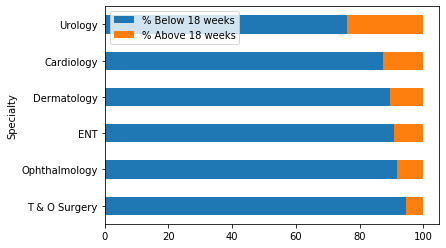

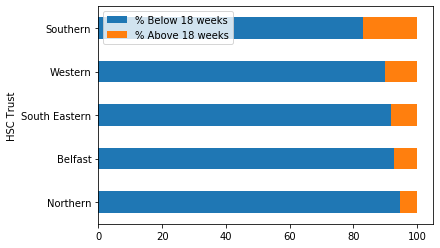

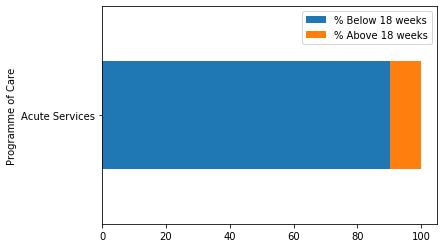

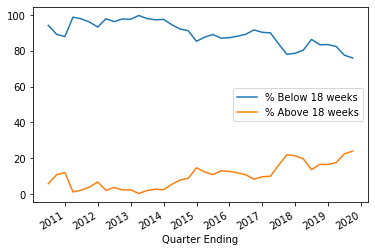

In [482]:
ICATSWL=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-icats-q2-19-20.csv");ICATSWLA=ICATSWL.drop_duplicates();ICATSWL=ICATSWLA.drop([689,691,692,693,694]);ICATSWL=ICATSWL.dropna(axis='columns');ICATSWL=ICATSWL.fillna(0);ICATSWL.replace("--", 0, inplace=True)
ICATSWL = ICATSWL.infer_objects();ICATSWL['Quarter Ending']=pd.to_datetime(ICATSWL['Quarter Ending']);ICATSWL.iloc[:, 4] = ICATSWL.iloc[:, 4].str.replace(",","").astype(float); ICATSWL.iloc[:, 6] = ICATSWL.iloc[:, 6].str.replace(",","").astype(float);ICATSWL.iloc[:, 7] = ICATSWL.iloc[:, 7].str.replace(",","").astype(float); ICATSWL.iloc[:, 8] = ICATSWL.iloc[:, 8].str.replace(",","").astype(float); ICATSWL.iloc[:, 9] = ICATSWL.iloc[:, 9].str.replace(",","").astype(float); ICATSWL.iloc[:, 10] = ICATSWL.iloc[:, 10].str.replace(",","").astype(float); ICATSWL.iloc[:, 11] = ICATSWL.iloc[:, 11].str.replace(",","").astype(float); ICATSWL.iloc[:, 12] = ICATSWL.iloc[:, 12].str.replace(",","").astype(float); ICATSWL.iloc[:, 13] = ICATSWL.iloc[:, 13].str.replace(",","").astype(float);ICATSWL=ICATSWL.fillna(0)
#ICATSWL.head()
ICATSWL['Below 18 weeks']= ICATSWL.iloc[:, 4:10].sum(axis=1);
ICATSWL['Above 18 weeks'] = ICATSWL['Total Waiting '].sub(ICATSWL['Below 18 weeks'], axis = 0)

ICATSWL['Quarter Ending']=pd.to_datetime(ICATSWL['Quarter Ending'])
ICATSWL['% Below 18 weeks'] = 100*ICATSWL['Below 18 weeks'].divide(ICATSWL["Total Waiting "], fill_value=1)
ICATSWL['% Above 18 weeks'] = 100*ICATSWL['Above 18 weeks'].divide(ICATSWL["Total Waiting "], fill_value=1)


ICATSWL.drop(ICATSWL.columns[[4,5,6,7,8,9,10,11,12,13,14,15]], axis = 1, inplace = True)
ICATSWL.head()


B=ICATSWL.groupby(['Specialty']).mean()
B = B.sort_values(by ='% Above 18 weeks' )
#B.plot.barh(stacked=True)

B.tail(15).plot.barh(stacked=True)

C=ICATSWL.groupby(['HSC Trust']).mean()
C = C.sort_values(by ='% Above 18 weeks' )
#C = B.sort_values(by ='% Above 26 weeks' )
C.plot.barh(stacked=True)

D=ICATSWL.groupby(['Programme of Care']).mean()
D = D.sort_values(by ='% Above 18 weeks' )
#C = B.sort_values(by ='% Above 26 weeks' )
D.plot.barh(stacked=True)


E=ICATSWL.groupby(['Quarter Ending']).mean()
E = E.sort_values(by ='% Above 18 weeks' )
#C = B.sort_values(by ='% Above 26 weeks' )
E.plot.line()
#(stacked=True)

#;
#

#ICATSWL.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 6134 entries, 0 to 6133
Data columns (total 6 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Quarter Ending     6134 non-null   object 
 1   HSC Trust          6134 non-null   object 
 2   Specialty          6134 non-null   object 
 3   Programme of Care  6134 non-null   object 
 4   % Below 26 weeks   6134 non-null   float64
 5   % Above 26 weeks   6134 non-null   float64
dtypes: float64(2), object(4)
memory usage: 335.5+ KB


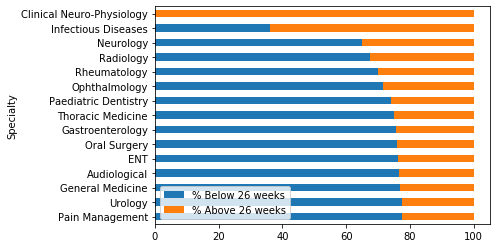

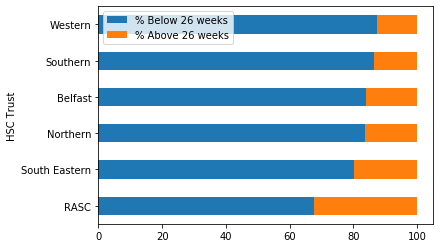

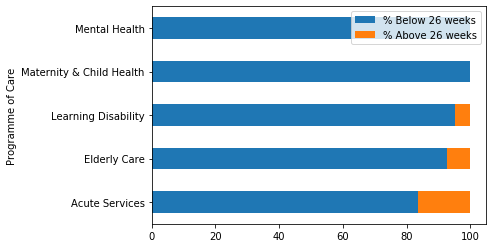

In [441]:
FirstCOPWL = pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-outpatients-q2-19-20.csv")
#Remove footer data
FirstCOPWL=FirstCOPWL.drop([6134,6135,6136,6137,6138]);
FirstCOPWL.dropna(axis='columns')
FirstCOPWL = FirstCOPWL.fillna(0)
FirstCOPWL.iloc[:, 1] = FirstCOPWL.iloc[:, 1].str.replace(" ","");
FirstCOPWL.iloc[:, 1] = FirstCOPWL.iloc[:, 1].str.replace("SouthEastern","South Eastern");
FirstCOPWL.iloc[:, 1] = FirstCOPWL.iloc[:, 1].str.replace("RegionalAssessmentandSurgicalCentre","RASC");
FirstCOPWL.iloc[:, 4] = FirstCOPWL.iloc[:, 4].str.replace(",","");FirstCOPWL.iloc[:, 4] = FirstCOPWL.iloc[:, 4].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 5] = FirstCOPWL.iloc[:, 5].str.replace(",","");FirstCOPWL.iloc[:, 5] = FirstCOPWL.iloc[:, 5].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 6] = FirstCOPWL.iloc[:, 6].str.replace(",","");FirstCOPWL.iloc[:, 6] = FirstCOPWL.iloc[:, 6].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 7] = FirstCOPWL.iloc[:, 7].str.replace(",","");FirstCOPWL.iloc[:, 7] = FirstCOPWL.iloc[:, 7].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 8] = FirstCOPWL.iloc[:, 8].str.replace(",","");FirstCOPWL.iloc[:, 8] = FirstCOPWL.iloc[:, 8].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 9] = FirstCOPWL.iloc[:, 9].str.replace(",","");FirstCOPWL.iloc[:, 9] = FirstCOPWL.iloc[:, 9].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 10] = FirstCOPWL.iloc[:, 10].str.replace(",","");FirstCOPWL.iloc[:, 10] = FirstCOPWL.iloc[:, 10].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 11] = FirstCOPWL.iloc[:, 11].str.replace(",","");FirstCOPWL.iloc[:, 11] = FirstCOPWL.iloc[:, 11].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 12] = FirstCOPWL.iloc[:, 12].str.replace(",","");FirstCOPWL.iloc[:, 12] = FirstCOPWL.iloc[:, 12].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 13] = FirstCOPWL.iloc[:, 13].str.replace(",","");FirstCOPWL.iloc[:, 13] = FirstCOPWL.iloc[:, 13].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 14] = FirstCOPWL.iloc[:, 14].str.replace(",","");FirstCOPWL.iloc[:, 14] = FirstCOPWL.iloc[:, 14].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 15] = FirstCOPWL.iloc[:, 15].str.replace(",","");FirstCOPWL.iloc[:, 15] = FirstCOPWL.iloc[:, 15].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 16] = FirstCOPWL.iloc[:, 16].str.replace(",","");FirstCOPWL.iloc[:, 16] = FirstCOPWL.iloc[:, 16].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 17] = FirstCOPWL.iloc[:, 17].str.replace(",","");FirstCOPWL.iloc[:, 17] = FirstCOPWL.iloc[:, 17].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 18] = FirstCOPWL.iloc[:, 18].str.replace(",","");FirstCOPWL.iloc[:, 18] = FirstCOPWL.iloc[:, 18].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 19] = FirstCOPWL.iloc[:, 19].str.replace(",","");FirstCOPWL.iloc[:, 19] = FirstCOPWL.iloc[:, 19].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 20] = FirstCOPWL.iloc[:, 20].str.replace(",","");FirstCOPWL.iloc[:, 20] = FirstCOPWL.iloc[:, 20].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 21] = FirstCOPWL.iloc[:, 21].str.replace(",","");FirstCOPWL.iloc[:, 21] = FirstCOPWL.iloc[:, 21].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 22] = FirstCOPWL.iloc[:, 22].str.replace(",","");FirstCOPWL.iloc[:, 22] = FirstCOPWL.iloc[:, 22].str.replace("--","0").astype(int);FirstCOPWL.iloc[:, 23] = FirstCOPWL.iloc[:, 23].str.replace(",","");FirstCOPWL.iloc[:, 23] = FirstCOPWL.iloc[:, 23].str.replace("--","0").astype(int);
FirstCOPWL = FirstCOPWL.infer_objects();
FirstCOPWL['Below 26 weeks']= FirstCOPWL.iloc[:, 4:10].sum(axis=1) + FirstCOPWL.iloc[:, 20];
FirstCOPWL['% Below 26 weeks'] = 100*FirstCOPWL['Below 26 weeks'].divide(FirstCOPWL["Total Waiting "], fill_value=1);
FirstCOPWL['% Above 26 weeks'] = 100 - FirstCOPWL['% Below 26 weeks']
FirstCOPWL.drop(FirstCOPWL.columns[[4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24]], axis = 1, inplace = True)
FirstCOPWL.info()

B=FirstCOPWL.groupby(['Specialty']).mean()
B = B.sort_values(by ='% Above 26 weeks' )
#B.plot.barh(stacked=True)

B.tail(15).plot.barh(stacked=True)

C=FirstCOPWL.groupby(['HSC Trust']).mean()
C = C.sort_values(by ='% Below 26 weeks' )
#C = B.sort_values(by ='% Above 26 weeks' )
C.plot.barh(stacked=True)

D=FirstCOPWL.groupby(['Programme of Care']).mean()
D = D.sort_values(by ='% Below 26 weeks' )
#C = B.sort_values(by ='% Above 26 weeks' )
D.plot.barh(stacked=True)


#E=FirstCOPWL.groupby(['Quarter Ending']).mean()
#E = E.sort_values(by ='% Above 18 weeks' )
#C = B.sort_values(by ='% Above 26 weeks' )
#E.plot.line()


In [306]:
#DayCaseIPWL['Quarter Ending']=pd.to_datetime(DayCaseIPWL['Quarter Ending'])
DayCaseIPWL.info()
#DayCaseIPWL.head()
#['Quarter Ending']=pd.to_datetime(DayCaseIPWL['Quarter Ending'])
#TotalIPWL.info()
#TotalIPWL['Quarter Ending']=pd.to_datetime((TotalIPWL['Quarter Ending']),'13000101', format='%Y%m%d', errors='ignore')
#TotalIPWL.iloc[:, 0]=TotalIPWL.iloc[:, 0].astype(datetime)
#('13000101', format='%Y%m%d', errors='ignore')



<class 'pandas.core.frame.DataFrame'>
Int64Index: 4399 entries, 0 to 4398
Data columns (total 9 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Quarter Ending     4399 non-null   object 
 1   HSC Trust          4399 non-null   object 
 2   Specialty          4399 non-null   object 
 3   Programme of Care  4399 non-null   object 
 4   0 - 6 weeks        4399 non-null   float64
 5   > 6 - 13 weeks     4399 non-null   float64
 6   > 13 - 21 weeks    4399 non-null   float64
 7   > 21 - 26 weeks    4399 non-null   float64
 8   Total              4399 non-null   float64
dtypes: float64(5), object(4)
memory usage: 343.7+ KB


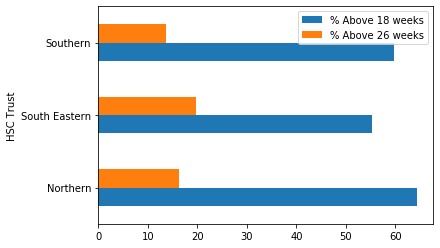

In [486]:
C=CentralCOPWL.groupby(['HSC Trust'])["% Above 18 weeks"].mean()
#['% Below 18 weeks ']['% Above 18 weeks']
#C=C['% Below 26 weeks']
A=FirstCOPWL.groupby(['HSC Trust'])["% Above 26 weeks"].mean()
#C=ICATSWL.groupby(['HSC Trust']).mean()



#B=ICATSWL.groupby(['HSC Trust'])["% Above 18 weeks"].mean()
#C=CentralCOPWL.groupby(['HSC Trust'])
#C=CWT14D.groupby(['HSCTrust']).mean()
#D=TotalIPWL.groupby(['HSCTrust']).mean()
#A.plot.bar()
#B.plot.bar()
join = pd.concat([C,A], axis=1, join='inner')
#join.head()
join.plot.barh()
#print("Graphs of the Out Patient waiting times by Trust")

#C=TotalIPWL.groupby(['> 26 - 36 weeks'])['Total'].mean()
#B.info()
#TotalIPWL['range'] = TotalIPWL['range'].str.replace(',','-')
#df

In [ ]:
C=CentralCOPWL.groupby(['HSC Trust'])["% Above 18 weeks"].mean()
#['% Below 18 weeks ']['% Above 18 weeks']
#C=C['% Below 26 weeks']
A=FirstCOPWL.groupby(['HSC Trust'])["% Above 26 weeks"].mean()
#C=ICATSWL.groupby(['HSC Trust']).mean()



#B=ICATSWL.groupby(['HSC Trust'])["% Above 18 weeks"].mean()
#C=CentralCOPWL.groupby(['HSC Trust'])
#C=CWT14D.groupby(['HSCTrust']).mean()
#D=TotalIPWL.groupby(['HSCTrust']).mean()
#A.plot.bar()
#B.plot.bar()
join = pd.concat([C,A], axis=1, join='inner')
#join.head()
join.plot.barh()
#print("Graphs of the Out Patient waiting times by Trust")

#C=TotalIPWL.groupby(['> 26 - 36 weeks'])['Total'].mean()
#B.info()
#TotalIPWL['range'] = TotalIPWL['range'].str.replace(',','-')
#df

In [699]:
ICATSWL=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-icats-q2-19-20.csv")
ICATSWLA=ICATSWL.drop_duplicates();ICATSWL=ICATSWLA.drop([689,691,692,693,694]);ICATSWL=ICATSWL.dropna(axis='columns');ICATSWL=ICATSWL.fillna(0)
ICATSWL.replace("--", 0, inplace=True)
ICATSWL = ICATSWL.infer_objects()
ICATSWL.iloc[:, 4] = ICATSWL.iloc[:, 4].str.replace(",","").astype(float); ICATSWL.iloc[:, 6] = ICATSWL.iloc[:, 6].str.replace(",","").astype(float);ICATSWL.iloc[:, 7] = ICATSWL.iloc[:, 7].str.replace(",","").astype(float); ICATSWL.iloc[:, 8] = ICATSWL.iloc[:, 8].str.replace(",","").astype(float); ICATSWL.iloc[:, 9] = ICATSWL.iloc[:, 9].str.replace(",","").astype(float); ICATSWL.iloc[:, 10] = ICATSWL.iloc[:, 10].str.replace(",","").astype(float); ICATSWL.iloc[:, 11] = ICATSWL.iloc[:, 11].str.replace(",","").astype(float); ICATSWL.iloc[:, 12] = ICATSWL.iloc[:, 12].str.replace(",","").astype(float); ICATSWL.iloc[:, 13] = ICATSWL.iloc[:, 13].str.replace(",","").astype(float);ICATSWL=ICATSWL.fillna(0)
ICATSWL['Quarter Ending']=pd.to_datetime(ICATSWL['Quarter Ending'])

ICATSWL=ICATSWL.fillna(0)
ICATSWL['Below 26 weeks']= ICATSWL.iloc[:, 4:10].sum(axis=1);
ICATSWL['% Below 26 weeks'] = 100*ICATSWL['Below 26 weeks'].divide(ICATSWL["Total Waiting "], fill_value=1)
ICATSWL['% Above 26 weeks'] = 100-100*ICATSWL['Below 26 weeks'].divide(ICATSWL["Total Waiting "], fill_value=1)
ICATSWL.drop(ICATSWL.columns[[4,5,6,7,8,9,10,11,12,13,14]], axis = 1, inplace = True)
#Remove footer data

DayCaseIPWL=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-day-cases-q2-19-20.csv")
DayCaseIPWL.replace("--", 0, inplace=True)
#Remove footer data
DayCaseIPWL=DayCaseIPWL.drop([4399,4400,4401,4402,4403,4404,4405,4406,4407,4408,4409,4410,4411,4412]);DayCaseIPWL.drop(DayCaseIPWL.columns[DayCaseIPWL.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True);DayCaseIPWL.replace("--", 0, inplace=True);DayCaseIPWL.fillna(0)
DayCaseIPWL=DayCaseIPWL.dropna(axis='columns');DayCaseIPWL=DayCaseIPWL.fillna(0);DayCaseIPWL.iloc[:, 4] = DayCaseIPWL.iloc[:, 4].str.replace(",","").astype(float);DayCaseIPWL.iloc[:, 5] = DayCaseIPWL.iloc[:, 5].str.replace(",","").astype(float);DayCaseIPWL.iloc[:, 6] = DayCaseIPWL.iloc[:, 6].str.replace(",","").astype(float);DayCaseIPWL.iloc[:, 8] = DayCaseIPWL.iloc[:, 8].str.replace(",","").astype(float);


AdminIPWL=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-inpatients-q2-19-20.csv")
#Remove footer data
AdminIPWL=AdminIPWL.drop([2994,2995,2996,2997,2998,2999,3000,3001,3002,3003,3004,3005]);AdminIPWL=AdminIPWL.dropna(axis='columns');AdminIPWL=AdminIPWL.fillna(0);AdminIPWL.drop(AdminIPWL.columns[AdminIPWL.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True)
AdminIPWL.replace("--", 0, inplace=True)
AdminIPWL["0 - 6 weeks"] = AdminIPWL["Total"].str.replace(",","").astype(int);AdminIPWL["> 6 - 13 weeks"] = AdminIPWL["> 6 - 13 weeks"].str.replace(",","").astype(int);AdminIPWL["> 13 - 21 weeks"] = AdminIPWL["> 13 - 21 weeks"].str.replace(",","").astype(int);AdminIPWL["> 21 - 26 weeks"] = AdminIPWL["> 21 - 26 weeks"].str.replace(",","").astype(int);AdminIPWL["Total"] = AdminIPWL["Total"].str.replace(",","").astype(int)
AdminIPWL=AdminIPWL.dropna(axis='columns')

TotalIPWL=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-total-waiting-q2-19-20.csv");TotalIPWL=TotalIPWL.drop([4550,4551,4552,4553,4554,4555,4556,4557,4558,4559,4560,4561]);TotalIPWL=TotalIPWL.fillna(0);TotalIPWL.drop(TotalIPWL.columns[TotalIPWL.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True);TotalIPWL["Total"] = TotalIPWL["Total"].str.replace(",","").astype(int)
TotalIPWL.replace("--", 0, inplace=True)
TotalIPWL.iloc[:, 4] = TotalIPWL.iloc[:, 4].str.replace(",","").astype(float); TotalIPWL.iloc[:, 5] = TotalIPWL.iloc[:, 5].str.replace(",","").astype(float); TotalIPWL.iloc[:, 7] = TotalIPWL.iloc[:, 7].str.replace(",","").astype(float); TotalIPWL.iloc[:, 8] = TotalIPWL.iloc[:, 8].str.replace(",","").astype(float); TotalIPWL.iloc[:, 9] = TotalIPWL.iloc[:, 9].str.replace(",","").astype(float); TotalIPWL.iloc[:, 6] = TotalIPWL.iloc[:, 6].str.replace(",","").astype(float); TotalIPWL.iloc[:, 10] = TotalIPWL.iloc[:, 10].str.replace(",","").astype(float); TotalIPWL.iloc[:, 11] = TotalIPWL.iloc[:, 11].str.replace(",","").astype(float); TotalIPWL.iloc[:, 13] = TotalIPWL.iloc[:, 13].str.replace(",","").astype(float); TotalIPWL.iloc[:, 14] = TotalIPWL.iloc[:, 14].str.replace(",","").astype(float);TotalIPWL.iloc[:, 15] = TotalIPWL.iloc[:, 15].str.replace(",","").astype(float); 
TotalIPWL=TotalIPWL.dropna(axis='columns')
TotalIPWL=TotalIPWL.fillna(0)
#TotalIPWL.iloc[:, 12] = TotalIPWL.iloc[:, 11].str.replace(",","").astype(float); 

TotalIPWL=TotalIPWL.fillna(0)
TotalIPWL['Below 26 weeks']= TotalIPWL.iloc[:, 4:8].sum(axis=1);
TotalIPWL['% Below 26 weeks'] = 100*TotalIPWL['Below 26 weeks'].divide(TotalIPWL["Total"], fill_value=1)
TotalIPWL['% Above 26 weeks'] = 100-100*TotalIPWL['Below 26 weeks'].divide(TotalIPWL["Total"], fill_value=1)

#TotalIPWL['Below 26 weeks']= TotalIPWL.iloc[:, 5:8].sum(axis=1);
TotalIPWL=TotalIPWL.fillna(0)
#AdminIPWL['Below 26 weeks']= AdminIPWL.iloc[:, 5:8].sum(axis=1);
TotalIPWL.iloc[:, 1] = TotalIPWL.iloc[:, 1].str.replace(" ","");
TotalIPWL.iloc[:, 1] = TotalIPWL.iloc[:, 1].str.replace("SouthEastern","South Eastern");
TotalIPWL.iloc[:, 1] = TotalIPWL.iloc[:, 1].str.replace("RegionalAssessmentandSurgicalCentre","RASC");



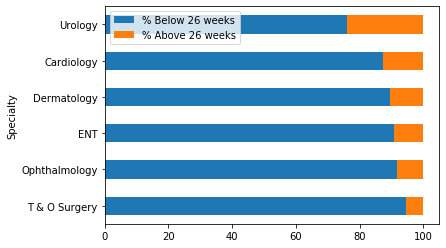

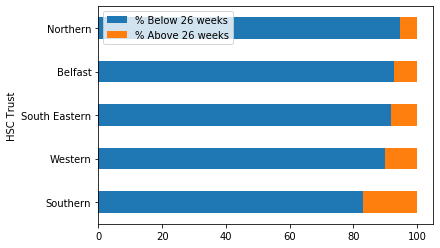

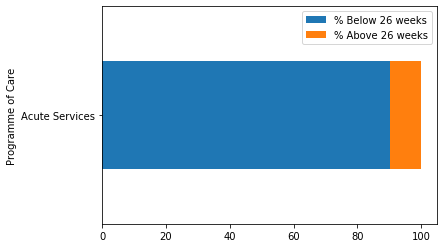

In [533]:
ICATSWL=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-icats-q2-19-20.csv")
ICATSWLA=ICATSWL.drop_duplicates();ICATSWL=ICATSWLA.drop([689,691,692,693,694]);ICATSWL=ICATSWL.dropna(axis='columns');ICATSWL=ICATSWL.fillna(0)
ICATSWL.replace("--", 0, inplace=True)
ICATSWL = ICATSWL.infer_objects()
ICATSWL.iloc[:, 4] = ICATSWL.iloc[:, 4].str.replace(",","").astype(float); ICATSWL.iloc[:, 6] = ICATSWL.iloc[:, 6].str.replace(",","").astype(float);ICATSWL.iloc[:, 7] = ICATSWL.iloc[:, 7].str.replace(",","").astype(float); ICATSWL.iloc[:, 8] = ICATSWL.iloc[:, 8].str.replace(",","").astype(float); ICATSWL.iloc[:, 9] = ICATSWL.iloc[:, 9].str.replace(",","").astype(float); ICATSWL.iloc[:, 10] = ICATSWL.iloc[:, 10].str.replace(",","").astype(float); ICATSWL.iloc[:, 11] = ICATSWL.iloc[:, 11].str.replace(",","").astype(float); ICATSWL.iloc[:, 12] = ICATSWL.iloc[:, 12].str.replace(",","").astype(float); ICATSWL.iloc[:, 13] = ICATSWL.iloc[:, 13].str.replace(",","").astype(float);ICATSWL=ICATSWL.fillna(0)
ICATSWL['Quarter Ending']=pd.to_datetime(ICATSWL['Quarter Ending'])

ICATSWL=ICATSWL.fillna(0)
ICATSWL['Below 26 weeks']= ICATSWL.iloc[:, 4:10].sum(axis=1);
ICATSWL['% Below 26 weeks'] = 100*ICATSWL['Below 26 weeks'].divide(ICATSWL["Total Waiting "], fill_value=1)
ICATSWL['% Above 26 weeks'] = 100-100*ICATSWL['Below 26 weeks'].divide(ICATSWL["Total Waiting "], fill_value=1)
ICATSWL.drop(ICATSWL.columns[[4,5,6,7,8,9,10,11,12,13,14]], axis = 1, inplace = True)
ICATSWL.head()



B=ICATSWL.groupby(['Specialty']).mean()
B = B.sort_values(by ='% Above 26 weeks' )
#B.plot.barh(stacked=True)

B.tail(15).plot.barh(stacked=True)

C=ICATSWL.groupby(['HSC Trust']).mean()
C = C.sort_values(by ='% Below 26 weeks' )
#C = B.sort_values(by ='% Above 26 weeks' )
C.head(6).plot.barh(stacked=True)

D=ICATSWL.groupby(['Programme of Care']).mean()
D = D.sort_values(by ='% Below 26 weeks' )
#C = B.sort_values(by ='% Above 26 weeks' )
D.plot.barh(stacked=True)

#ICATSWL.head()

#C=ICATSWL.groupby(['HSC Trust'])["% Above 18 weeks"].mean()
#['% Below 18 weeks ']['% Above 18 weeks']
#C=C['% Below 26 weeks']
#A=FirstCOPWL.groupby(['HSC Trust'])["% Above 26 weeks"].mean()
#C=ICATSWL.groupby(['HSC Trust']).mean()



#B=ICATSWL.groupby(['HSC Trust'])["% Above 18 weeks"].mean()
#C=CentralCOPWL.groupby(['HSC Trust'])
#C=CWT14D.groupby(['HSCTrust']).mean()
#D=TotalIPWL.groupby(['HSCTrust']).mean()
#A.plot.bar()
#B.plot.bar()
#join = pd.concat([C,A], axis=1, join='inner')
#join.head()
#join.plot.barh()

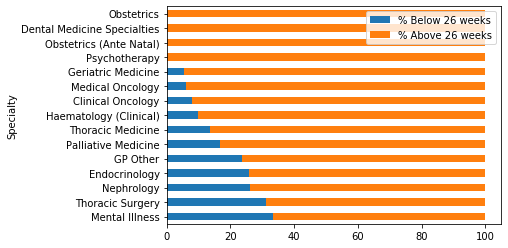

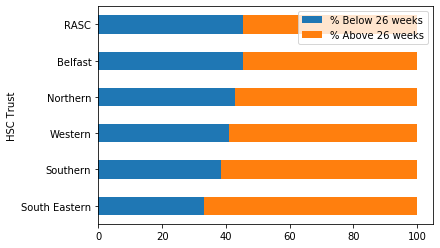

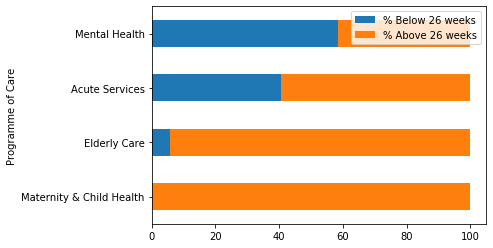

In [557]:
DayCaseIPWL=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-day-cases-q2-19-20.csv")
DayCaseIPWL.replace("--", 0, inplace=True)
#Remove footer data
DayCaseIPWL=DayCaseIPWL.drop([4399,4400,4401,4402,4403,4404,4405,4406,4407,4408,4409,4410,4411,4412]);DayCaseIPWL.drop(DayCaseIPWL.columns[DayCaseIPWL.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True);DayCaseIPWL.replace("--", 0, inplace=True);DayCaseIPWL.fillna(0)
DayCaseIPWL=DayCaseIPWL.dropna(axis='columns');DayCaseIPWL=DayCaseIPWL.fillna(0);DayCaseIPWL.iloc[:, 4] = DayCaseIPWL.iloc[:, 4].str.replace(",","").astype(float);DayCaseIPWL.iloc[:, 5] = DayCaseIPWL.iloc[:, 5].str.replace(",","").astype(float);DayCaseIPWL.iloc[:, 6] = DayCaseIPWL.iloc[:, 6].str.replace(",","").astype(float);DayCaseIPWL.iloc[:, 8] = DayCaseIPWL.iloc[:, 8].str.replace(",","").astype(float);

DayCaseIPWL=DayCaseIPWL.fillna(0)
DayCaseIPWL['Below 26 weeks']= DayCaseIPWL.iloc[:, 5:8].sum(axis=1);
DayCaseIPWL['% Below 26 weeks'] = 100*DayCaseIPWL['Below 26 weeks'].divide(DayCaseIPWL["Total"], fill_value=1)
DayCaseIPWL['% Above 26 weeks'] = 100-100*DayCaseIPWL['Below 26 weeks'].divide(DayCaseIPWL["Total"], fill_value=1)
DayCaseIPWL.drop(DayCaseIPWL.columns[[4,5,6,7,8,9]], axis = 1, inplace = True)
DayCaseIPWL.head()
DayCaseIPWL.iloc[:, 1] = DayCaseIPWL.iloc[:, 1].str.replace(" ","");
DayCaseIPWL.iloc[:, 1] = DayCaseIPWL.iloc[:, 1].str.replace("SouthEastern","South Eastern");
DayCaseIPWL.iloc[:, 1] = DayCaseIPWL.iloc[:, 1].str.replace("RegionalAssessmentandSurgicalCentre","RASC");

#DayCaseIPWL['Quarter Ending']=pd.to_datetime(DayCaseIPWL['Quarter Ending'])

df=DayCaseIPWL
B=df.groupby(['Specialty']).mean()
B = B.sort_values(by ='% Above 26 weeks' )
#B.plot.barh(stacked=True)

B.tail(15).plot.barh(stacked=True)

C=df.groupby(['HSC Trust']).mean()
C = C.sort_values(by ='% Below 26 weeks' )
#C = B.sort_values(by ='% Above 26 weeks' )
C.tail(6).plot.barh(stacked=True)

D=df.groupby(['Programme of Care']).mean()
D = D.sort_values(by ='% Below 26 weeks' )
#C = B.sort_values(by ='% Above 26 weeks' )
D.tail(5).plot.barh(stacked=True)


,Quarter Ending,HSC Trust,Specialty,Programme of Care,% Below 26 weeks,% Above 26 weeks
0,30-Jun-2007,Belfast,General Surgery,Acute Services,53.949329,46.050671
1,30-Jun-2007,Belfast,Urology,Acute Services,46.511628,53.488372
2,30-Jun-2007,Belfast,T & O Surgery,Acute Services,69.320388,30.679612
3,30-Jun-2007,Belfast,ENT,Acute Services,65.722380,34.277620
4,30-Jun-2007,Belfast,Ophthalmology,Acute Services,58.390805,41.609195


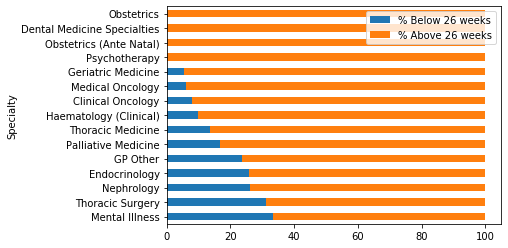

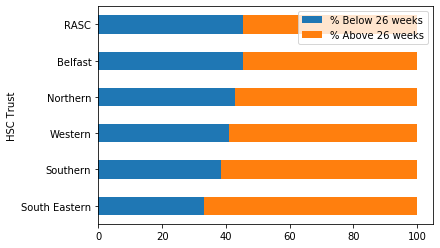

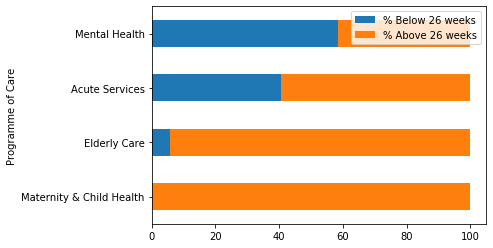

In [546]:
AdminIPWL=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-inpatients-q2-19-20.csv")
#Remove footer data
AdminIPWL=AdminIPWL.drop([2994,2995,2996,2997,2998,2999,3000,3001,3002,3003,3004,3005]);AdminIPWL=AdminIPWL.dropna(axis='columns');AdminIPWL=AdminIPWL.fillna(0);AdminIPWL.drop(AdminIPWL.columns[AdminIPWL.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True)
AdminIPWL.replace("--", 0, inplace=True)
AdminIPWL["0 - 6 weeks"] = AdminIPWL["Total"].str.replace(",","").astype(int);AdminIPWL["> 6 - 13 weeks"] = AdminIPWL["> 6 - 13 weeks"].str.replace(",","").astype(int);AdminIPWL["> 13 - 21 weeks"] = AdminIPWL["> 13 - 21 weeks"].str.replace(",","").astype(int);AdminIPWL["> 21 - 26 weeks"] = AdminIPWL["> 21 - 26 weeks"].str.replace(",","").astype(int);AdminIPWL["Total"] = AdminIPWL["Total"].str.replace(",","").astype(int)
AdminIPWL=AdminIPWL.dropna(axis='columns')

AdminIPWL=AdminIPWL.fillna(0)
#AdminIPWL['Below 26 weeks']= AdminIPWL.iloc[:, 5:8].sum(axis=1);
AdminIPWL.iloc[:, 1] = AdminIPWL.iloc[:, 1].str.replace(" ","");
AdminIPWL.iloc[:, 1] = AdminIPWL.iloc[:, 1].str.replace("SouthEastern","South Eastern");
AdminIPWL.iloc[:, 1] = AdminIPWL.iloc[:, 1].str.replace("RegionalAssessmentandSurgicalCentre","RASC");

#AdminIPWL['% Below 26 weeks'] = 100*AdminIPWL['Below 26 weeks'].divide(AdminIPWL["Total"], fill_value=1)
#AdminIPWL['% Above 26 weeks'] = 100-100*AdminIPWL['Below 26 weeks'].divide(AdminIPWL["Total"], fill_value=1)
#AdminIPWL.drop(AdminIPWL.columns[[4,5,6,7,8,9]], axis = 1, inplace = True)
#AdminIPWL.head()


df=AdminIPWL
B=df.groupby(['Specialty']).mean()
B = B.sort_values(by ='% Above 26 weeks' )

B.tail(15).plot.barh(stacked=True)

C=df.groupby(['HSC Trust']).mean()
C = C.sort_values(by ='% Below 26 weeks' )
C.tail(6).plot.barh(stacked=True)

D=df.groupby(['Programme of Care']).mean()
D = D.sort_values(by ='% Below 26 weeks' )
#C = B.sort_values(by ='% Above 26 weeks' )
D.tail(5).plot.barh(stacked=True)
AdminIPWL.head()


In [708]:
AdminIPWL
new=AdminIPWL["Quarter Ending"].str.split("-", n = 1, expand = True) 
#AdminIPWL["Month"]= new[0] 
#AdminIPWL["Year"]= '20' + new[1]
#AdminIPWL.drop(columns =["Month"], inplace = True) 
#AdminIPWL.head()
#= AdminIPWL[['Month', 'Year', 'Tumour Site', '% treated within 31 days']]

,Quarter Ending,HSC Trust,Specialty,Programme of Care,0 - 6 weeks,> 6 - 13 weeks,> 13 - 21 weeks,> 21 - 26 weeks,Total
0,30-Jun-2007,Belfast,General Surgery,Acute Services,1037,334,233,31,1037
1,30-Jun-2007,Belfast,Urology,Acute Services,433,133,108,14,433
2,30-Jun-2007,Belfast,T & O Surgery,Acute Services,2099,832,567,111,2099
3,30-Jun-2007,Belfast,ENT,Acute Services,1045,469,257,9,1045
4,30-Jun-2007,Belfast,Ophthalmology,Acute Services,315,110,78,6,315
...,...,...,...,...,...,...,...,...,...
2989,30-Sep-2019,Western,General Surgery,Acute Services,1442,64,129,45,1442
2990,30-Sep-2019,Western,Gynaecology,Acute Services,468,58,51,27,468
2991,30-Sep-2019,Western,Oral Surgery,Acute Services,87,8,11,2,87
2992,30-Sep-2019,Western,T & O Surgery,Acute Services,3199,156,206,140,3199


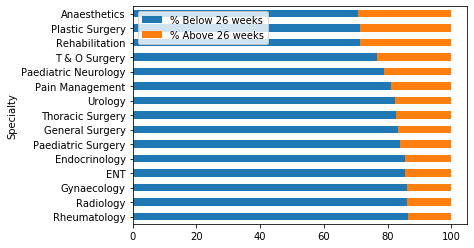

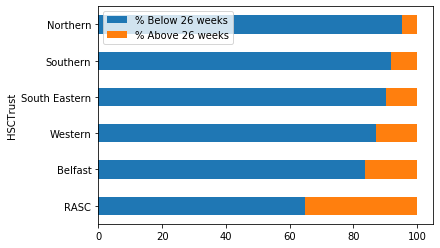

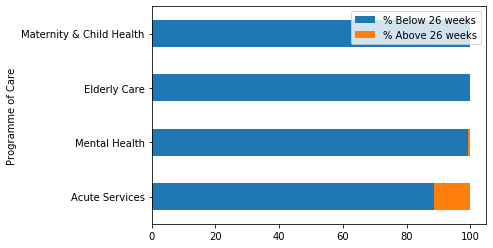

In [591]:
TotalIPWL=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-tables-total-waiting-q2-19-20.csv");TotalIPWL=TotalIPWL.drop([4550,4551,4552,4553,4554,4555,4556,4557,4558,4559,4560,4561]);TotalIPWL=TotalIPWL.fillna(0);TotalIPWL.drop(TotalIPWL.columns[TotalIPWL.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True);TotalIPWL["Total"] = TotalIPWL["Total"].str.replace(",","").astype(int)
TotalIPWL.replace("--", 0, inplace=True)
TotalIPWL.iloc[:, 4] = TotalIPWL.iloc[:, 4].str.replace(",","").astype(float); TotalIPWL.iloc[:, 5] = TotalIPWL.iloc[:, 5].str.replace(",","").astype(float); TotalIPWL.iloc[:, 7] = TotalIPWL.iloc[:, 7].str.replace(",","").astype(float); TotalIPWL.iloc[:, 8] = TotalIPWL.iloc[:, 8].str.replace(",","").astype(float); TotalIPWL.iloc[:, 9] = TotalIPWL.iloc[:, 9].str.replace(",","").astype(float); TotalIPWL.iloc[:, 6] = TotalIPWL.iloc[:, 6].str.replace(",","").astype(float); TotalIPWL.iloc[:, 10] = TotalIPWL.iloc[:, 10].str.replace(",","").astype(float); TotalIPWL.iloc[:, 11] = TotalIPWL.iloc[:, 11].str.replace(",","").astype(float); TotalIPWL.iloc[:, 13] = TotalIPWL.iloc[:, 13].str.replace(",","").astype(float); TotalIPWL.iloc[:, 14] = TotalIPWL.iloc[:, 14].str.replace(",","").astype(float);TotalIPWL.iloc[:, 15] = TotalIPWL.iloc[:, 15].str.replace(",","").astype(float); 
TotalIPWL=TotalIPWL.dropna(axis='columns')
TotalIPWL=TotalIPWL.fillna(0)
#TotalIPWL.iloc[:, 12] = TotalIPWL.iloc[:, 11].str.replace(",","").astype(float); 

TotalIPWL=TotalIPWL.fillna(0)
TotalIPWL['Below 26 weeks']= TotalIPWL.iloc[:, 4:8].sum(axis=1);
TotalIPWL['% Below 26 weeks'] = 100*TotalIPWL['Below 26 weeks'].divide(TotalIPWL["Total"], fill_value=1)
TotalIPWL['% Above 26 weeks'] = 100-100*TotalIPWL['Below 26 weeks'].divide(TotalIPWL["Total"], fill_value=1)

TotalIPWL['Below 26 weeks']= TotalIPWL.iloc[:, 5:8].sum(axis=1);
TotalIPWL=TotalIPWL.fillna(0)
#AdminIPWL['Below 26 weeks']= AdminIPWL.iloc[:, 5:8].sum(axis=1);
TotalIPWL.iloc[:, 1] = TotalIPWL.iloc[:, 1].str.replace(" ","");
TotalIPWL.iloc[:, 1] = TotalIPWL.iloc[:, 1].str.replace("SouthEastern","South Eastern");
TotalIPWL.iloc[:, 1] = TotalIPWL.iloc[:, 1].str.replace("RegionalAssessmentandSurgicalCentre","RASC");

#AdminIPWL['% Below 26 weeks'] = 100*AdminIPWL['Below 26 weeks'].divide(AdminIPWL["Total"], fill_value=1)
#AdminIPWL['% Above 26 weeks'] = 100-100*AdminIPWL['Below 26 weeks'].divide(AdminIPWL["Total"], fill_value=1)
TotalIPWL.drop(TotalIPWL.columns[[4,5,6,7,8,9,10]], axis = 1, inplace = True)
#AdminIPWL.head()


df=TotalIPWL
B=df.groupby(['Specialty']).mean()
B = B.sort_values(by ='% Above 26 weeks' )

B.tail(15).plot.barh(stacked=True)

C=df.groupby(['HSCTrust']).mean()
C = C.sort_values(by ='% Below 26 weeks' )
C.tail(6).plot.barh(stacked=True)

D=df.groupby(['Programme of Care']).mean()
D = D.sort_values(by ='% Below 26 weeks' )
#C = B.sort_values(by ='% Above 26 weeks' )
D.tail(5).plot.barh(stacked=True)
#TotalIPWL.head()

#E=df.groupby(['Quarter Ending']).mean()
#E = E.sort_values(by ='% Below 26 weeks' )
#C = B.sort_values(by ='% Above 26 weeks' )
#E.tail(5).plot.line()
#(stacked=True)


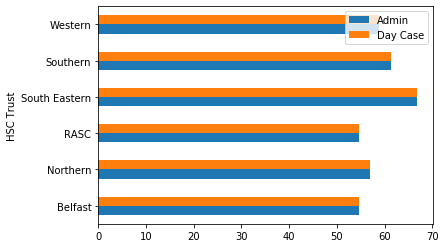

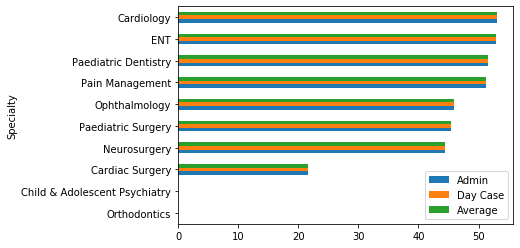

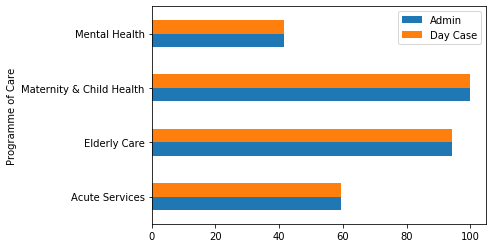

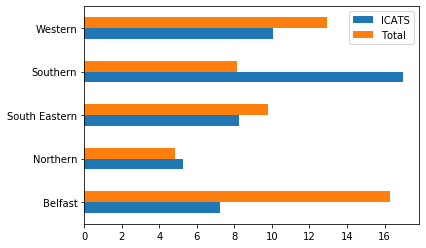

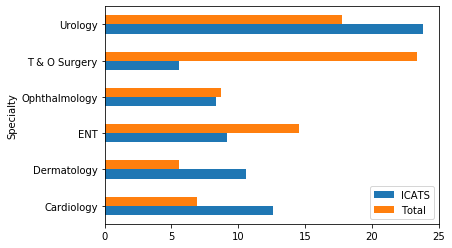

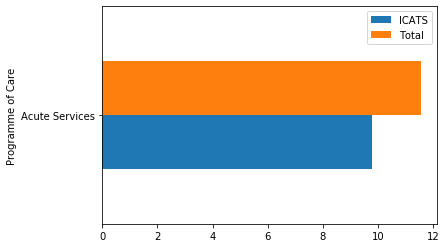

In [698]:
A=AdminIPWL.groupby(['HSC Trust'])["% Above 26 weeks"].mean()
B=DayCaseIPWL.groupby(['HSC Trust'])["% Above 26 weeks"].mean()
C=TotalIPWL.groupby(['HSCTrust'])["% Above 26 weeks"].mean()
D=ICATSWL.groupby(['HSC Trust'])["% Above 26 weeks"].mean()
#['% Below 18 weeks ']['% Above 18 weeks']
#C=C['% Below 26 weeks']
join = pd.concat([A,B],keys=["Admin", "Day Case"], axis=1, join='inner')
#join.head()
join.plot.barh()



#join1.plot(kind='barh', ax=ax)
#ax.legend(["Total Inpatient", "ICAT Inpatient"]);

#B=ICATSWL.groupby(['Specialty']).mean()


A1=AdminIPWL.groupby(['Specialty'])["% Above 26 weeks"].mean()
B1=DayCaseIPWL.groupby(['Specialty'])["% Above 26 weeks"].mean()
C1=TotalIPWL.groupby(['Specialty'])["% Above 26 weeks"].mean()
D1=ICATSWL.groupby(['Specialty'])["% Above 26 weeks"].mean()
#['% Below 18 weeks ']['% Above 18 weeks']
#C=C['% Below 26 weeks']
#join2 = pd.concat([A1,B1], axis=1, join='inner')
join2 =pd.concat([A1,B1,(A1+B1)/2], keys=["Admin", "Day Case", "Average"], axis=1, join='inner');
#join.head()

join2 = join2.sort_values(by ='Average' )
#join2.sort_values(by ='joint2.column[0]' )
#join1.tail(15).plot.barh(stacked=True)
join2.head(10).plot.barh()
joint2.head()




A2=AdminIPWL.groupby(['Programme of Care'])["% Above 26 weeks"].mean()
B2=DayCaseIPWL.groupby(['Programme of Care'])["% Above 26 weeks"].mean()
C2=TotalIPWL.groupby(['Programme of Care'])["% Above 26 weeks"].mean()
D2=ICATSWL.groupby(['Programme of Care'])["% Above 26 weeks"].mean()
#['% Below 18 weeks ']['% Above 18 weeks']
#C=C['% Below 26 weeks']
join4 = pd.concat([A2,B2],keys=["Admin", "Day Case"], axis=1, join='inner')
#join.head()

join4 = join4.sort_values(by ='Programme of Care' )
#join1.tail(15).plot.barh(stacked=True)
join4.tail(15).plot.barh()




#D=df.groupby(['Programme of Care']).mean()
#D = D.sort_values(by ='% Below 26 weeks' )
#C = B.sort_values(by ='% Above 26 weeks' )
#D.tail(5).plot.barh(stacked=True)

#.columns[1]


join1 = pd.concat([D,C],keys=["ICATS", "Total"], axis=1, join='inner')
#join.head()
join1.plot.barh()

join3 = pd.concat([D1,C1],keys=["ICATS", "Total"], axis=1, join='inner')
#join.head()

join3 = join3.sort_values(by ='Specialty' )
#join1.tail(15).plot.barh(stacked=True)
join3.head(15).plot.barh()

join5 = pd.concat([D2,C2],keys=["ICATS", "Total"], axis=1, join='inner')
#join.head()

join5 = join5.sort_values(by ='Programme of Care' )
#join1.tail(15).plot.barh(stacked=True)
join5.tail(15).plot.barh()



In [689]:
#rename
A1=AdminIPWL.groupby(['Specialty'])["% Above 26 weeks"].mean()
#A1.rename(columns={"% Above 26 weeks": "Admin"})
B1=DayCaseIPWL.groupby(['Specialty'])["% Above 26 weeks"].mean()
C1=TotalIPWL.groupby(['Specialty'])["% Above 26 weeks"].mean()
D1=ICATSWL.groupby(['Specialty'])["% Above 26 weeks"].mean()
#['% Below 18 weeks ']['% Above 18 weeks']
#C=C['% Below 26 weeks']
#join2 = pd.concat([A1,B1], axis=1, join='inner');

#joint=
#joint.rename(columns={'% Above 26 weeks':'average'}, 
                # inplace=True)
join2 =pd.concat([A1,B1,(A1+B1)/2], keys=["Admin", "Day Case", "Average"], axis=1, join='inner');

join2=join2.sort_values(by ='Average' )
join2.head()
#join2.index.name = None;
#join2.dropna(inplace=True)

#join2=join2.rename({1: "Total", 2: "ICATS"}, axis='1'});
#join2.index.name = None;
#join2.index.name = None;
#join2.head()
#join2.rename(df.rename(index={0: "x", 1: "y", 2: "z"}))
#join2.columns[2]='ICATS'
#join2.info()

#joint2.rename(joint2.columns[1]:'Total'), inplace=True)
#join2.columns[1]='Total'
#join2.columns[2]='ICATS'

#joint3=joint2.sort_values(by ='joint2.columns[1]' )


,Admin,Day Case,Average
Specialty,,,
Orthodontics,0.000000,0.000000,0.000000
Child & Adolescent Psychiatry,0.000000,0.000000,0.000000
Cardiac Surgery,21.568627,21.568627,21.568627
Neurosurgery,44.407442,44.407442,44.407442
Paediatric Surgery,45.414051,45.414051,45.414051


## Clean the Cancer Waiting Lists

In [68]:
HSCT31DCWT=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-cwt-31-day-wait-by-trust-q1-19-20.csv")
HSCT31DCWT=HSCT31DCWT.dropna(axis='columns')
new=HSCT31DCWT["Treatment Month"].str.split("-", n = 1, expand = True) 
HSCT31DCWT["Treatment_Month"]= new[0] ;HSCT31DCWT["Treatment Year"]= '20' + new[1]
HSCT31DCWT.drop(columns =["Treatment Month"], inplace = True) 
HSCT31DCWT = HSCT31DCWT[['Treatment_Month', 'Treatment Year', 'HSC Trust', '% treated within 31 days']]


HSCT62DCWT=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-cwt-62-day-wait-by-trust-q1-19-20.csv")
#remove NA columns
HSCT62DCWT=HSCT62DCWT.dropna(axis='columns')
new=HSCT62DCWT["Treatment Month"].str.split("-", n = 1, expand = True) 
HSCT62DCWT["Treatment_Month"]= new[0] 
HSCT62DCWT["Treatment Year"]= '20' + new[1]
HSCT62DCWT.drop(columns =["Treatment Month"], inplace = True) 
HSCT62DCWT = HSCT62DCWT[['Treatment_Month', 'Treatment Year', 'HSC Trust', '% treated within 62 days']]


TS31DCWT=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-cwt-31-day-wait-by-tumour-q1-19-20.csv")  
TS31DCWT.drop(TS31DCWT.columns[TS31DCWT.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True)
TS31DCWT.replace("--", 
           0, 
           inplace=True)
TS31DCWT.replace("-", 
           0.0, 
           inplace=True)
#TS31DCWT=TS31DCWT.dropna(axis='columns')
new=TS31DCWT["Treatment Month"].str.split("-", n = 1, expand = True) 
TS31DCWT["Treatment_Month"]= new[0] 
TS31DCWT["Treatment Year"]= '20' + new[1]
TS31DCWT.drop(columns =["Treatment Month"], inplace = True) 
TS31DCWT= TS31DCWT[['Treatment_Month', 'Treatment Year', 'Tumour Site', '% treated within 31 days']]

TS62DCWT=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-cwt-62-day-wait-by-tumour-q1-19-20.csv")
TS62DCWT.drop(TS62DCWT.columns[TS62DCWT.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True)
TS62DCWT.replace("--", 
           0, 
           inplace=True)
TS62DCWT.replace("-", 
           0, 
           inplace=True)
new=TS62DCWT["Treatment Month"].str.split("-", n = 1, expand = True) 
TS62DCWT["Treatment_Month"]= new[0] 
TS62DCWT["Treatment Year"]= '20' + new[1]
TS62DCWT.drop(columns =["Treatment Month"], inplace = True) 
TS62DCWT= TS62DCWT[['Treatment_Month', 'Treatment Year', 'Tumour Site', '% treated within 62 days']]
#TS62DCWT=TS62DCWT.dropna(axis='columns')


CWT14D=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-cwt-14-day-wait-q1-19-20.csv")
CWT14D=CWT14D.dropna(axis='columns')
new2=CWT14D["Month Seen"].str.split("-", n = 1, expand = True) 
CWT14D["Month_Seen"]= new[0] 
CWT14D["Year Seen"]= '20' + new[1]
CWT14D.drop(columns =["Month Seen"], inplace = True) 
CWT14D = CWT14D[['Month_Seen', 'Year Seen', 'HSC Trust', '% seen within 14 days']]


print("All Cancer Data Imported")

All Cancer Data Imported


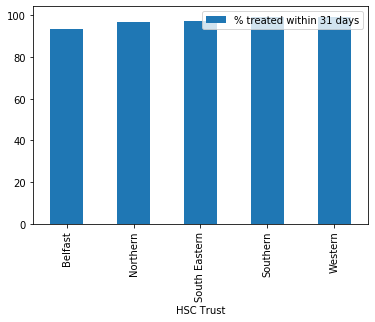

In [69]:
HSCT31DCWT.head()
test=HSCT31DCWT.groupby(["HSC Trust"]).mean()
test.plot.bar()


#TwentySixtoMax = DayCaseIPWL['> 26-30 weeks'] + DayCaseIPWL['>26-52 weeks'] + DayCaseIPWL['>30-36 weeks'] + DayCaseIPWL['> 26 - 36 weeks']
#Max=DayCaseIPWL['> 26 weeks'] + DayCaseIPWL['>52 weeks'] + DayCaseIPWL['> 36 weeks'] 


#DayCaseIPWL['Max'] = DayCaseIPWL.loc[:,'> 26 weeks'].add(DayCaseIPWL.loc[:,'> 36 weeks'])
#DayCaseIPWL['Max'] = DayCaseIPWL.loc[:,['> 26 weeks','> 36 weeks','>52 weeks']].sum(axis=1)
#DayCaseIPWL['Max']  = DayCaseIPWL.apply(lambda x: x['> 26 weeks'] +x['> 36 weeks'], axis=1)
#DayCaseIPWL.describe()
#df.loc[:,'> 26-30 weeks'] = df.loc[:,'> 26-30 weeks'] = df.loc[:,'budget'].add(df.loc[:,'actual'])
#DayCaseIPWL=DayCaseIPWL.dropna(axis='columns')
#DayCaseIPWL=DayCaseIPWL.dropna(axis='columns')
#new3=DayCaseIPWL["Quarter Ending"].str.split("-", n = 1, expand = True) 
#DayCaseIPWL["QE Day"]= new2[0] 
#DayCaseIPWL["QE Month"]= new2[1]
#DayCaseIPWL["QE Year"]= new2[2]
#DayCaseIPWL.drop(columns =["Quarter Ending"], inplace = True) 
#DayCaseIPWL = DayCaseIPWL[['QE Month','QE Year', 'HSC Trust','Specialty','Programme of Care','0 - 6 weeks','6 - 13 weeks','> 13 - 21 weeks','> 21 - 26 weeks','Total']]


In [70]:
new2=TS62DCWT[['Tumour Site', '% treated within 62 days']]
new2[pd.to_numeric(new2['% treated within 62 days'], errors='coerce').notnull()]
new2
C=new2.groupby(['Tumour Site'])



## Graphical Experiments

In [71]:
new2=TS62DCWT[['Tumour Site', '% treated within 62 days']]
new2[pd.to_numeric(new2['% treated within 62 days'], errors='coerce').notnull()]
new2
C=new2.groupby(['Tumour Site'])



In [72]:
TS31DCWT=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-cwt-31-day-wait-by-tumour-q1-19-20.csv")  
TS31DCWT.drop(TS31DCWT.columns[TS31DCWT.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True)
TS31DCWT.replace("--", 
           0, 
           inplace=True)
TS31DCWT.replace("-", 
           0.0, 
           inplace=True)
#TS31DCWT=TS31DCWT.dropna(axis='columns')
new=TS31DCWT["Treatment Month"].str.split("-", n = 1, expand = True) 
TS31DCWT["Treatment_Month"]= new[0] 
TS31DCWT["Treatment Year"]= '20' + new[1]
TS31DCWT.drop(columns =["Treatment Month"], inplace = True) 
TS31DCWT= TS31DCWT[['Treatment_Month', 'Treatment Year', 'Tumour Site', '% treated within 31 days']]
#A=TS31DCWT.groupby(['% treated within 31 days'])
#A.describe()
A=TS31DCWT.groupby(['Tumour Site'])
A.head()


,Treatment_Month,Treatment Year,Tumour Site,% treated within 31 days
0,Dec,2008,Brain/Central Nervous System,100.0
1,Dec,2008,Breast Cancer,100.0
2,Dec,2008,Gynae Cancers,100.0
3,Dec,2008,Haematological Cancers,100.0
4,Dec,2008,Head/Neck Cancer,95.5
...,...,...,...,...
1164,Jan,2017,Brain Central Tumour,91.7
1176,Feb,2017,Brain Central Tumour,100.0
1188,Mar,2017,Brain Central Tumour,100.0
1200,Apr,2017,Brain Central Tumour,100.0


Graphs of the Cancer waiting times by Trust


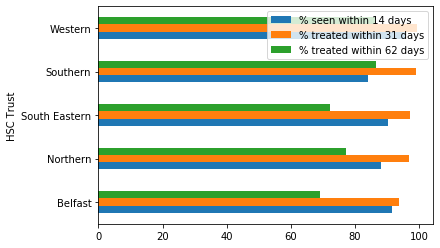

In [73]:
#CANCER WAITING TIMES
A=HSCT31DCWT.groupby(['HSC Trust']).mean()
B=HSCT62DCWT.groupby(['HSC Trust']).mean()
C=CWT14D.groupby(['HSC Trust']).mean()
#A.plot.bar()
#B.plot.bar()
join = pd.concat([C,A,B], axis=1, join='inner')
join.plot.barh()
print("Graphs of the Cancer waiting times by Trust")

Graphs of the Cancer waiting times by Treatment Time


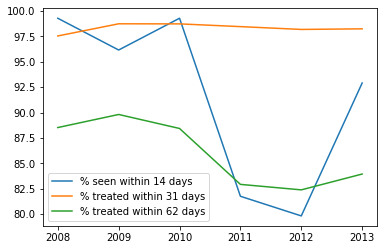

In [74]:
#CANCER WAITING TIMES
#df.month = pd.to_datetime(df.month, unit='s')
#['Treatment Month']
A=HSCT31DCWT.groupby(['Treatment Year']).mean()
B=HSCT62DCWT.groupby(['Treatment Year']).mean()
C=CWT14D.groupby(['Year Seen']).mean()
D = pd.concat([C,A,B], axis=1, join='inner')
D.plot.line()
print("Graphs of the Cancer waiting times by Treatment Time")



#plt.zlabel('14 days')

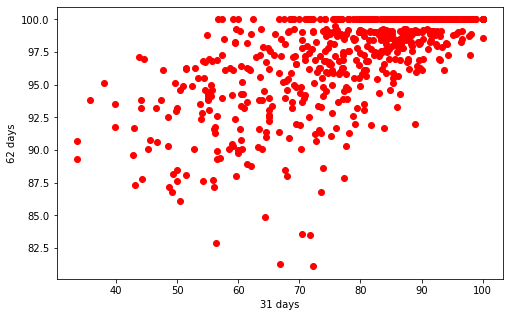

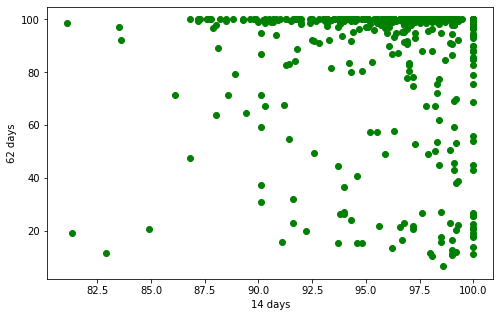

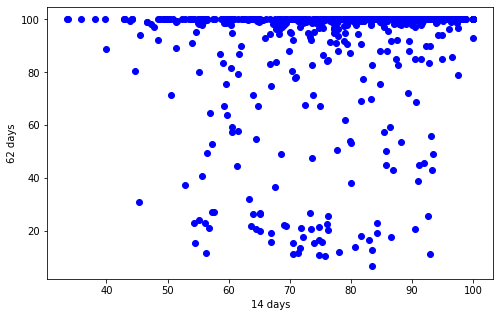

In [75]:

plt.figure(figsize=(8,5))
x_data, y_data = (HSCT62DCWT["% treated within 62 days"].values, HSCT31DCWT["% treated within 31 days"].values)
plt.plot(x_data, y_data,'ro')
plt.ylabel('62 days')
plt.xlabel('31 days')
plt.show()


plt.figure(figsize=(8,5))
x_data, y_data = (HSCT31DCWT["% treated within 31 days"].values, CWT14D['% seen within 14 days'].values)
plt.plot(x_data, y_data, 'go')
plt.ylabel('62 days')
plt.xlabel('14 days')
plt.show()


plt.figure(figsize=(8,5))
x_data, y_data = (HSCT62DCWT["% treated within 62 days"].values, CWT14D['% seen within 14 days'].values)
plt.plot(x_data, y_data, 'bo')
plt.ylabel('62 days')
plt.xlabel('14 days')
plt.show()

#sns.regplot(x='x_data', y='y_data', data=df)

In [76]:
HSCT31DCWT.info()
HSCT62DCWT.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 675 entries, 0 to 674
Data columns (total 4 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Treatment_Month           675 non-null    object 
 1   Treatment Year            675 non-null    object 
 2   HSC Trust                 675 non-null    object 
 3   % treated within 31 days  675 non-null    float64
dtypes: float64(1), object(3)
memory usage: 21.2+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 675 entries, 0 to 674
Data columns (total 4 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Treatment_Month           675 non-null    object 
 1   Treatment Year            675 non-null    object 
 2   HSC Trust                 675 non-null    object 
 3   % treated within 62 days  675 non-null    float64
dtypes: float64(1), object(3)
memory usage: 21.2+ KB


[[99.1246875  89.9059375 ]
 [93.3        55.70074074]
 [96.76636364 75.26636364]]


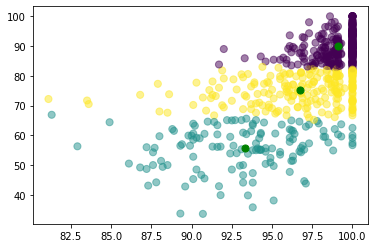

[[95.84565217 61.56086957]
 [96.27407407 21.31111111]
 [97.38486957 98.61547826]]


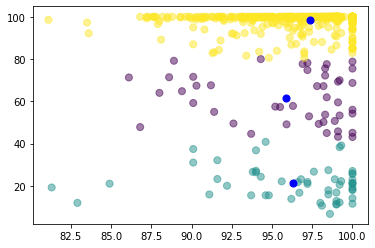

[[60.72259887 95.71525424]
 [86.66952381 98.45809524]
 [73.06410256 30.67307692]]


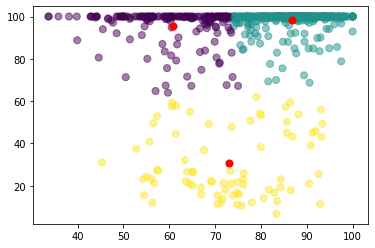

In [77]:
from pandas import DataFrame
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

n_clusters=3
#Data =x_data, y_data = (HSCT31DCWT["% treated within 31 days"].values, CWT14D['% seen within 14 days'].values)
#x_data, y_data = (HSCT62DCWT["% treated within 62 days"].values, HSCT31DCWT["% treated within 31 days"].values)


Data = {'x': HSCT31DCWT["% treated within 31 days"].values,
        'y': HSCT62DCWT["% treated within 62 days"].values,
        'z': CWT14D['% seen within 14 days']
       }
  
df = DataFrame(Data,columns=['x','y'])

df1 = DataFrame(Data,columns=['x','z'])
df2 = DataFrame(Data,columns=['y','z'])
  
kmeans = KMeans(n_clusters).fit(df)
centroids = kmeans.cluster_centers_
print(centroids)

plt.scatter(df['x'], df['y'], c= kmeans.labels_.astype(float), s=50, alpha=0.5)
plt.scatter(centroids[:, 0], centroids[:, 1], c='green', s=50)
plt.show()

  
kmeans = KMeans(n_clusters).fit(df1)
centroids = kmeans.cluster_centers_
print(centroids)

plt.scatter(df1['x'], df1['z'], c= kmeans.labels_.astype(float), s=50, alpha=0.5)
plt.scatter(centroids[:, 0], centroids[:, 1], c='blue', s=50)
plt.show()

kmeans = KMeans(n_clusters).fit(df2)
centroids = kmeans.cluster_centers_
print(centroids)

plt.scatter(df2['y'], df2['z'], c= kmeans.labels_.astype(float), s=50, alpha=0.5)
plt.scatter(centroids[:, 0], centroids[:, 1], c='red', s=50)
plt.show()


In [78]:
!pip install sklearn

Note: you may need to restart the kernel to use updated packages.


In [80]:
#X=HSCT62DCWT["% treated within 62 days"]
#Y=CWT14D['% seen within 14 days"]
#lm.fit(X,Y)

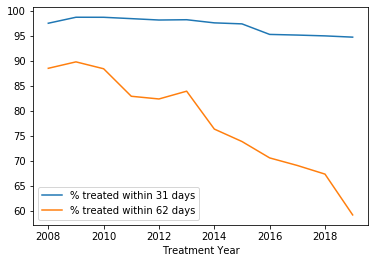

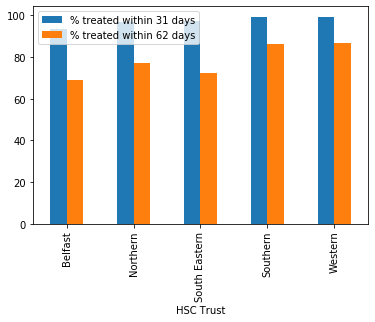

In [81]:
#HSCT31DCWT=pd.read_csv(r"https://www.health-ni.gov.uk/sites/default/files/publications/health/hs-niwts-cwt-31-day-wait-by-trust-q1-19-20.csv")
#HSCT31DCWT=HSCT31DCWT.dropna(axis='columns')
#new=HSCT31DCWT["Treatment Month"].str.split("-", n = 1, expand = True) 
#HSCT31DCWT["Treatment_Month"]= new[0] 
#HSCT31DCWT["Treatment Year"]= '20' + new[1]
#HSCT31DCWT.drop(columns =["Treatment Month"], inplace = True) 
#HSCT31DCWT = HSCT31DCWT[['Treatment_Month', 'Treatment Year', 'HSC Trust', '% treated within 31 days']]

E=HSCT31DCWT.groupby(['Treatment Year']).mean()
#E.plot.line()
F=HSCT31DCWT.groupby(['HSC Trust']).mean()
#F.plot.bar()
G=HSCT62DCWT.groupby(['Treatment Year']).mean()
#G.plot.line()
H=HSCT62DCWT.groupby(['HSC Trust']).mean()
#H.plot.bar()

J = pd.concat([E,G], axis=1, join='inner')
J.plot.line()

K = pd.concat([F,H], axis=1, join='inner')
K.plot.bar()



In [82]:
!pip install folium

Note: you may need to restart the kernel to use updated packages.


In [83]:
import numpy as np 
import pandas as pd
from sklearn.tree import DecisionTreeClassifier


# now, read data using pandas dataframe:    
my_data = DiagnosticRTT
my_data[0:5]

# Remove the column containing the target name since it doesn't contain numeric values.
X = my_data[['% reported within 2 days','% reported within 2 weeks','% reported within 4 weeks','>28 days\t']].values
X[0:5]

# As you may figure out, some features in this dataset are categorical such as Sex or BP.
from sklearn import preprocessing
#le_Pri = preprocessing.LabelEncoder()
#le_Pri.fit(['ROUTINE','URGENT'])
#X[:,1] = le_Pri.transform(X[:,1]) 


#le_BP = preprocessing.LabelEncoder()
#le_BP.fit([ 'LOW', 'NORMAL', 'HIGH'])
#X[:,2] = le_BP.transform(X[:,2])


#le_Chol = preprocessing.LabelEncoder()
#le_Chol.fit([ 'NORMAL', 'HIGH'])
#X[:,3] = le_Chol.transform(X[:,3]) 

#X[0:5]

# Now we can fill the target variable.
y = my_data["HSC Trust"]
y[0:5]

# Setting up the Decision Tree
# We will be using train/test split on our decision tree. 
# Let's import train_test_split from sklearn.cross_validation.

from sklearn.model_selection import train_test_split

X_trainset, X_testset, y_trainset, y_testset = train_test_split(X, y, test_size=0.3, random_state=3)

# Modeling
# We will first create an instance of the DecisionTreeClassifier called drugTree.
# Inside of the classifier, specify criterion="entropy" so we can see the information gain of each node.

trustTree = DecisionTreeClassifier(criterion="entropy", max_depth = 4)
trustTree # it shows the default parameters

# Next, we will fit the data with the training feature matrix X_trainset and training response vector y_trainset
trustTree.fit(X_trainset,y_trainset)

# Prediction
# Let's make some predictions on the testing dataset and store it into a variable called predTree.

predTree = trustTree.predict(X_testset)

# You can print out predTree and y_testset if you want to visually compare the prediction to the actual values.

print (predTree [0:5])
print (y_testset [0:5])

# Evaluation
# Next, let's import metrics from sklearn and check the accuracy of our model.

from sklearn import metrics
import matplotlib.pyplot as plt
print("DecisionTrees's Accuracy: ", metrics.accuracy_score(y_testset, predTree))

['Southern' 'Belfast' 'Western' 'Southern' 'Southern']
3691         Southern
6578    South Eastern
6270          Belfast
6656         Northern
8448         Southern
Name: HSC Trust, dtype: object
DecisionTrees's Accuracy:  0.33668341708542715


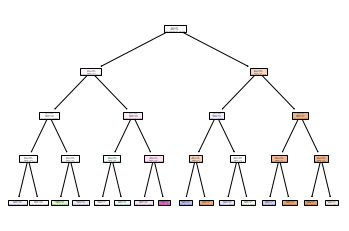

In [96]:
from sklearn import tree
tree.plot_tree(trustTree, filled=True)
#plot_tree(clf, )
plt.show()

In [59]:
#import geopandas as gpd
#import matplotlib.pyplot as plt

In [24]:
#df=EmergWL
import folium
from folium import LayerControl
#IFrame, FeatureGroup, LayerControl, Map, Marker, plugins
import numpy as np
import geojson
import pandas as pd


NResults = pd.read_csv(r"https://raw.githubusercontent.com/KPBreslin/FinalProject/master/Trust.csv")
#NResults=NResults.groupby("HSC Trust").mean()
#NResults['HSC Trust']= NResults['Trust']
#NResults.head()
GeoJ=r"https://www.opendatani.gov.uk/dataset/0b04b46c-49af-45d5-b277-91b10937a01b/resource/645f8eef-8813-47a9-bb1e-a4932ada721a/download/trustboundaries.geojson";
#GeoJ2 = requests.get(GeoJ).json()
#json.dumpsjson.load(open(GeoJ, 'r')
                    

#df=EmergWL
#EmergWL['Trust'].value_counts()
#df['% Above Four Weeks']= 100*df['FourAndUnder_sum'].divide(df["Total_sum"], fill_value=1).astype(int) 
#df['TrustName']= df['Trust']

#df_trust = df['% Above Four Weeks'].groupby(df['TrustName']).mean().astype(int)
#df_trust = df_trust.reset_index()
#df_trust.rename(columns ={'% Above Four Weeks':'mean'}, inplace = True)

#df_trust = df_trust.sort_values('mean', ascending = False)
#df_trust.reset_index(drop=True, inplace = True)
#df_trust.to_json('GeoJ')
#df_trust.reset_index(drop=True, inplace = True)
#df_trust.columns = ['TrustName', '% Above Four Weeks']

TrustMap = folium.Map(location=[54.6, -7.7], tiles='Mapbox Bright', zoom_start=8)
m=TrustMap

#geo_str = json.dumps(json.load(open(GeoJ, 'r')))

#G=df.groupby('Trust')['% Above Four Weeks'].mean()
#G


#df_trust[['TrustName']] = df_trust[['TrustName']].astype('float')

#Total = district_data['Crime_Count'].sum()
#print (Total)
#Mean = df_trust['% Above Four Weeks'].mean()
#print (Mean)

#district_data[['district']] = district_data[['district']].astype('float')
#display_side_by_side(df_trust.sort_values('ward', ascending=True),district_data.sort_values('district', ascending=True))

#bins = list(df_trust['% Above Four Weeks'].quantile([0.01, 0.25, 0.5, 1]))




TrustMap.choropleth(geo_data = GeoJ,
                data = NResults,
                columns = ['TrustName', 'PC Above Four Weeks'],
                 key_on='feature.properties.TrustName',
                  
                 fill_color='YlGn',
                 fill_opacity=0.7,
                 line_opacity=0.2,
                threshold_scale=[0,10,20,30,40],
                legend_name = '% Above Four Weeks')
               

#folium.TileLayer('cartodbdark_matter').add_to(m)
folium.TileLayer('Stamen Terrain').add_to(m)
#folium.TileLayer('Stamen Toner').add_to(m)
#folium.TileLayer('Mapbox Bright').add_to(m)

#m.add_child(feature_group)
m.add_child(folium.map.LayerControl())




title_html = '''
             <h3 align="center" style="font-size:20px"><b>Choropleth Map</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
    
    
m
#Trust_dict['AL']

